#### Import libraries

In [1]:
import os
import xarray as xr
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import matplotlib.dates as mdates
import seaborn as sns

import cartopy.crs as ccrs

from matplotlib.backends.backend_pdf import PdfPages

#### Useful lists

In [2]:
months_names = ['January', 'Febrary', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
#months_names = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
titles=['MAE', 'ME', 'rSD', 'Corr', 'A. Corr', 'KGE']
cmap = 'viridis'

#### Upload data

#### Ground True

In [3]:
frames_predict = 12

masked = False

path_dir = os.path.join(os.getcwd(), '..', 'input_data', 'hourly')
#path_dir = os.path.join(os.getcwd(), '..', '..', 'Test_data', 'input_data')


if masked:
    print('Loading masked input data')
    ds_in_valid = xr.open_dataset(os.path.join(path_dir, 'masked_input_data', 'valid_data_hourly_masked.nc'))
    
else:
    print('Loading input data')
    ds_in_valid = xr.open_dataset(os.path.join(path_dir, 'valid_data_hourly_m_s_2020_2020.nc'))

ds_mask_spain = xr.open_dataset(os.path.join(path_dir, 'mask_spain.nc'))

Loading input data


In [4]:
in_valid = ds_in_valid["ws"]
mask_spain = ds_mask_spain["mask_spain"]

In [5]:
valid_input = in_valid.isel(time=slice(0, -frames_predict))
valid_target = in_valid.isel(time=slice(frames_predict, None))

In [6]:
del ds_in_valid, ds_mask_spain

#### Prediction

In [7]:
epoch = 60

path_out = '/media/cide/DATOS/Trained_Models/STSF_Prediction_results/Hourly_Wind_Speed_Data/ConvLSTM'
path_out ='/media/cide/DATOS/Trained_Models/STSF_Prediction_results/AEMET_ERA5/Hourly_Wind_Speed_Data/ConvLSTM/Frames_Predict/Mean_STD/'
#path_out = os.path.join(os.getcwd(), '..', 'experiments')
#path_out = os.path.join(os.getcwd(), '..', '..', 'Test_data')

models = os.listdir(path_out)

print(models)

['convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_12', 'convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_15', 'convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_18', 'convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_21', 'convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_24', 'convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_3', 'convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_6', 'convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_9']


In [8]:
model = models[0]
print(model)

path_out = os.path.join(path_out, model, 'predictions')

if masked:
    print('Loading masked output data')
    ds_out_valid = xr.open_dataset(os.path.join(path_out, 'masked_input_data', 'pred_valid_epoch_{}_masked.nc'.format(epoch)))

else:
    print('Loading output data')
    ds_out_valid = xr.open_dataset(os.path.join(path_out, 'valid', 'pred_valid_epoch_{}.nc'.format(epoch)))

convlstm_mae_5_PerPixel_mean-std_hourly_100_epochs_FP_12
Loading output data


In [9]:
valid_preds = ds_out_valid["preds"]

In [10]:
del ds_out_valid

#### Open the result file

In [11]:
#print(os.path.join(path_out, '..', 'Monthly_analysis.pdf'))
pdf = PdfPages(os.path.join(path_out, '..', 'Monthly_analysis.pdf'))

#### Distributions

In [12]:
def plot_monthly_histogram(data1, data2, bins=50):
    """
    Plot histograms of predictions vs observations, separated by months.
    
    Args:
        data1 (xarray.DataArray): Predictions (it should have a coordinate called 'time').
        data2 (xarray.DataArray): Observation (it should have a coordinate called 'time').
        bins (int): Number of bins for the histograms.
    
    Returns:
        plt.Figure: Figure with 12 histograms.
    """
    # Validate the time coordinate
    if not (data1['time'].equals(data2['time'])):
        raise ValueError("Both DataArrays should contain compatible time coordinates.")
    
    fig, axes = plt.subplots(3, 4, figsize=(20, 15))
    axes = axes.ravel()  # Flatten the array of axes for easier iteration
    
    for month in range(1, 13):
        ax = axes[month - 1]
        
        # Filter data for the current month
        x = data1.sel(time=data1.time.dt.month == month).values.reshape(-1)
        y = data2.sel(time=data2.time.dt.month == month).values.reshape(-1)

        # Plot histograms
        ax.hist(x, bins=bins, alpha=0.5, color='blue', label='Prediction')
        ax.hist(y, bins=bins, alpha=0.5, color='orange', label='Observation')

        # Set titles and labels
        ax.set_title(f'Month: {months_names[month - 1]}', fontsize=14)
        ax.set_xlabel('wind speed (m/s)')
        ax.set_ylabel('Frequency')
        ax.grid(True)
        ax.legend()
    
    plt.tight_layout()
    plt.suptitle('Prediction vs Observation distributions per month', fontsize=16)
    plt.subplots_adjust(top=0.93)
    pdf.savefig()
    plt.show()

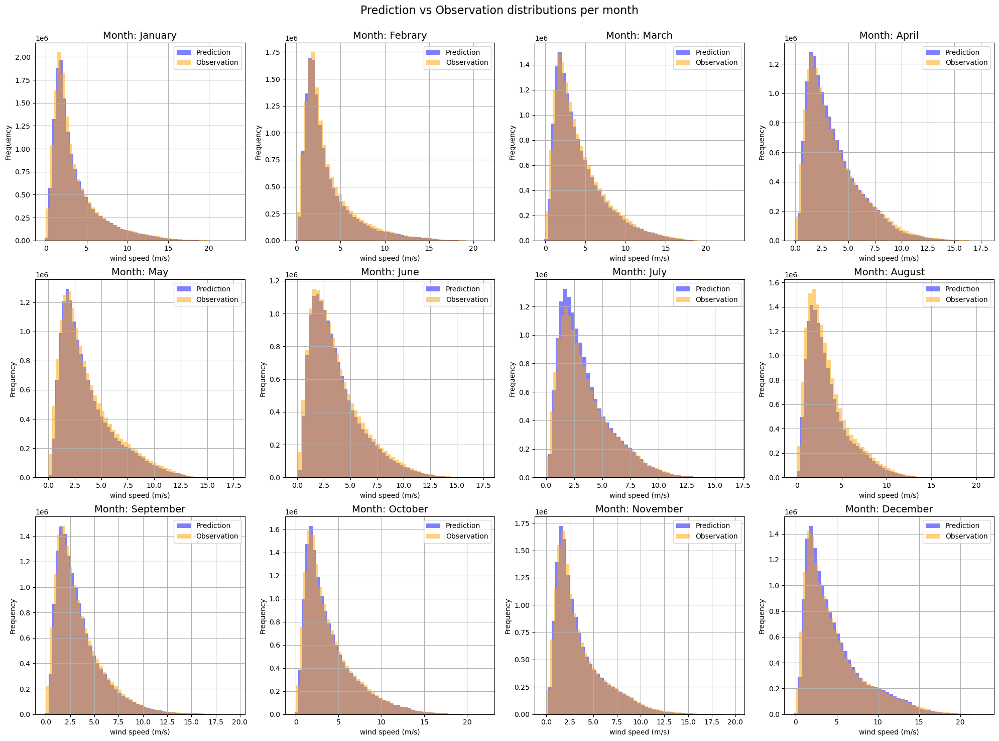

In [13]:
plot_monthly_histogram(valid_preds, valid_target)

In [14]:
def plot_monthly_hexbin(predic, obs, gridsize=50, cmap="viridis", vmin=None, vmax=None, Log=False):
    """
    Create a hexbin histogram for each month of the year.
    inputs:
        - `predic` (xarray.DataArray): Predictions (it should have a coordinate called 'time').
        - `obs` (xarray.DataArray): Observations (it should have a coordinate called 'time').
        - `gridsize` (int): Size of the hexagonal network.
        - `cmap` (str): Color map for the hexbin plot.
        - `vmin` (float): Minimum value for the color map.
        - `vmax` (float): Maximum value for the color map.
        - `Log` (bool): If True, the color map will be in logarithmic scale.
    """
    # Configura el estilo de seaborn
    sns.set(style="whitegrid")

    # Crea la figura para los subplots
    fig, axes = plt.subplots(3, 4, figsize=(15, 10))
    axes = axes.ravel()

    # Itera sobre los meses (1 a 12)
    for month in range(1, 13):
        print(months_names[month-1])

        ax = axes[month-1]

        # Filtra los datos para el mes actual
        x = predic.sel(time=predic.time.dt.month == month).values.reshape(-1)
        y = obs.sel(time=obs.time.dt.month == month).values.reshape(-1)

        # Crea el gráfico hexbin
        if Log:
            hb = ax.hexbin(y, x, gridsize=gridsize, cmap=cmap, norm=LogNorm(vmin=vmin, vmax=vmax), mincnt=1)
        else:
            hb = ax.hexbin(y, x, gridsize=gridsize, cmap=cmap, vmin=vmin, vmax=vmax, mincnt=1)

        # Añade la línea diagonal
        ax.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=1)

        # Configura el título del subplot
        ax.set_title(months_names[month-1])

        # Añade una barra de color
        cbar = fig.colorbar(hb, ax=ax, orientation='vertical', shrink=0.8)
        cbar.set_label("Counts")

        #ax.set_xlim([10, 25])
        #ax.set_ylim([10, 25])

    # Configuración general de los ejes
    fig.supxlabel("Observed wind speed")
    fig.supylabel("Predicted wind speed")


    # Ajusta el diseño
    plt.tight_layout()
    plt.suptitle('Prediction vs Observation histogram per month', fontsize=16)
    plt.subplots_adjust(top=0.93)
    pdf.savefig()
    plt.show()

January
Febrary
March
April
May
June
July
August
September
October
November
December


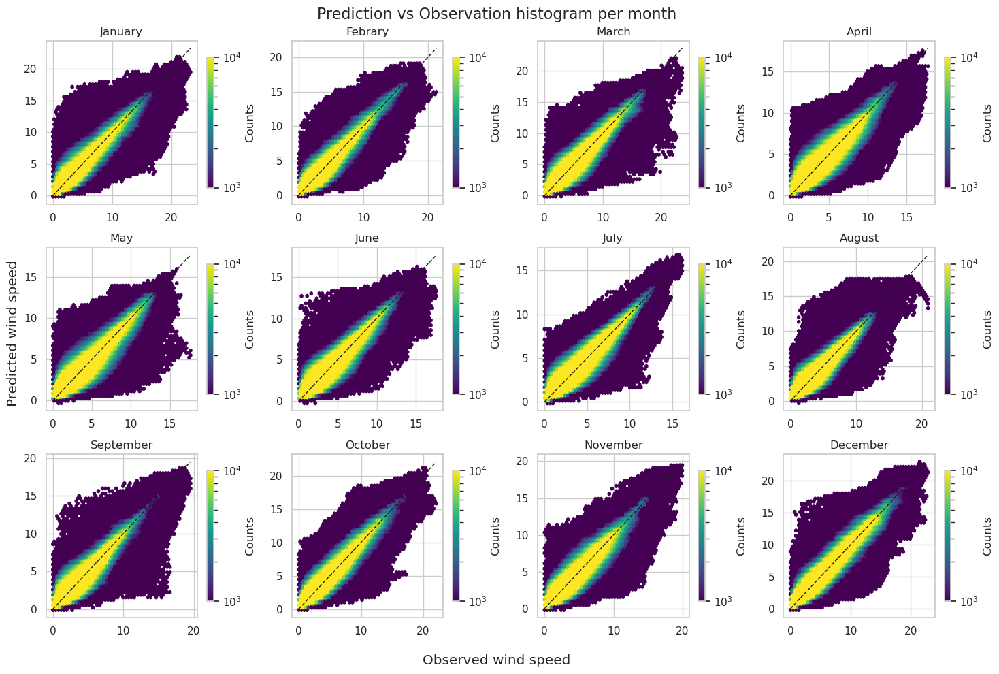

In [15]:
plot_monthly_hexbin(valid_preds, valid_target, vmin=1000, vmax=10000, Log=True)

#### Percentiles

#### Violin plots

#### S-mode

In [16]:
#percentiles = ['05', '25', '50', 'mean', '75', '95']
percentiles = [5, 25, 50, 75, 95]

results = {
    "Month": [],
    "Time": [],
    "Percentile": [],
    "Value": [],
    "Type": []
}

# Iterar por cada mes (1 a 12)
for month in range(1, 13):
    print('Month: %d' % month)
    # Filtrar datos por mes
    pred_month = valid_preds.sel(time=valid_preds.time.dt.month == month)
    obs_month = valid_target.sel(time=valid_target.time.dt.month == month)
    
    # Iterar por cada paso temporal
    for t in pred_month.time:
        pred_values = pred_month.sel(time=t).values.flatten()  # Datos de predicción en este paso temporal
        obs_values = obs_month.sel(time=t).values.flatten()  # Datos observados en este paso temporal
        
        # Calcular percentiles para este paso temporal
        for p in percentiles:
            results["Month"].append(month)
            results["Time"].append(str(t.values))  # Convertir a string para almacenamiento
            results["Percentile"].append(p)
            results["Value"].append(np.percentile(pred_values, p))
            results["Type"].append("Predicted")
            
            results["Month"].append(month)
            results["Time"].append(str(t.values))
            results["Percentile"].append(p)
            results["Value"].append(np.percentile(obs_values, p))
            results["Type"].append("Observed")
        
        # Calcular la media para este paso temporal
        results["Month"].append(month)
        results["Time"].append(str(t.values))
        results["Percentile"].append('Mean')
        results["Value"].append(np.mean(pred_values))
        results["Type"].append("Predicted")
        
        results["Month"].append(month)
        results["Time"].append(str(t.values))
        results["Percentile"].append('Mean')
        results["Value"].append(np.mean(obs_values))
        results["Type"].append("Observed")

# Convertir los resultados a un DataFrame para análisis posterior
Percentiles_S = pd.DataFrame(results, columns=['Month', 'Time', 'Percentile', 'Value', 'Type'])

Month: 1
Month: 2
Month: 3
Month: 4
Month: 5
Month: 6
Month: 7
Month: 8
Month: 9
Month: 10
Month: 11
Month: 12


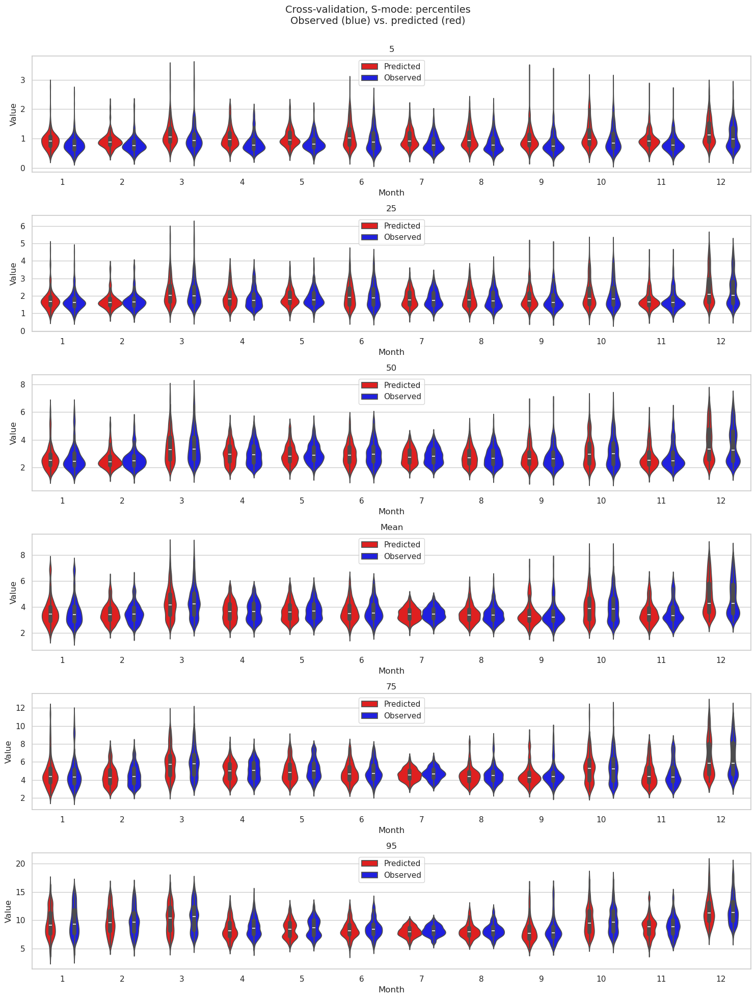

In [27]:
# Crear la figura y los subplots
percentiles = [5, 25, 50, 'Mean', 75, 95]
fig, axes = plt.subplots(6, 1, figsize=(15, 20))#, sharex=True, sharey=True)
axes = axes.flatten()

for i, percentile in enumerate(percentiles):
    ax = axes[i]
    sns.violinplot(data=Percentiles_S[Percentiles_S['Percentile'] == percentile], x='Month', y='Value', hue='Type', dodge=True, palette={'Observed': 'blue', 'Predicted': 'red'}, ax=ax, legend=True)
    ax.set_title(percentile)
    ax.set_ylabel('Value')
    ax.set_xlabel('Month')
    ax.legend(loc='best')

# Ajustar leyenda y diseño
fig.suptitle('Cross-validation, S-mode: percentiles\nObserved (blue) vs. predicted (red)', fontsize=14)
plt.tight_layout()
plt.subplots_adjust(top=0.93)
pdf.savefig()
plt.show()

#### Temporal serie of each percentile

In [23]:
def Temporal_Serie_S_Percentiles(data, percentile):
    '''
    Plot of monthly temporal series of a given percentile.
    Input:
    - data (DataFrame): DataFrame with the data.
    - percentile (str): Percentile to plot.
    '''

    # Create the figure and subplots
    fig, axes = plt.subplots(figsize=(15, 12), nrows=4, ncols=3)#, sharex=True, sharey=True)
    axes = axes.flatten()

    # Iterate over the months (1 to 12)
    for month in range(1, 13):
        # Filter data by month
        df_month = data[data["Month"] == month]
    
        # Filter data by percentile
        df_p = df_month[df_month["Percentile"] == percentile]        
        
        ax = axes[month - 1]
    
        ax.plot(df_p[df_p["Type"] == "Observed"]["Time"], df_p[df_p["Type"] == "Observed"]["Value"], "b-", label=f"Observed {percentile}th percentile")
        ax.plot(df_p[df_p["Type"] == "Predicted"]["Time"], df_p[df_p["Type"] == "Predicted"]["Value"], "r-", label=f"Predicted {percentile}th percentile")
    
        ax.set_title(f"{months_names[month - 1]}", fontsize=10)
        ax.legend(loc="upper right", fontsize=8)
        ax.set_ylabel(f"{percentile}th percentile")
        # To only show labels some subplots 
        if (month - 1) % 3 != 0:
            ax.set_ylabel("")
        #ax.set_xlabel("")

         # configure the x-axis to show the month
        ax.xaxis.set_major_locator(mdates.MonthLocator(interval=1))  # Un tick por mes
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%b'))  # Mostrar abreviatura del mes (e.g., 'Jan')
        ax.tick_params(axis='x', rotation=45, labelsize=8)
        
        

    plt.tight_layout()
    plt.suptitle(f"Cross-validation, S-mode: {percentile} Percentile time series", fontsize=14)
    plt.subplots_adjust(top=0.93, hspace=0.3)
    pdf.savefig()
    plt.show()

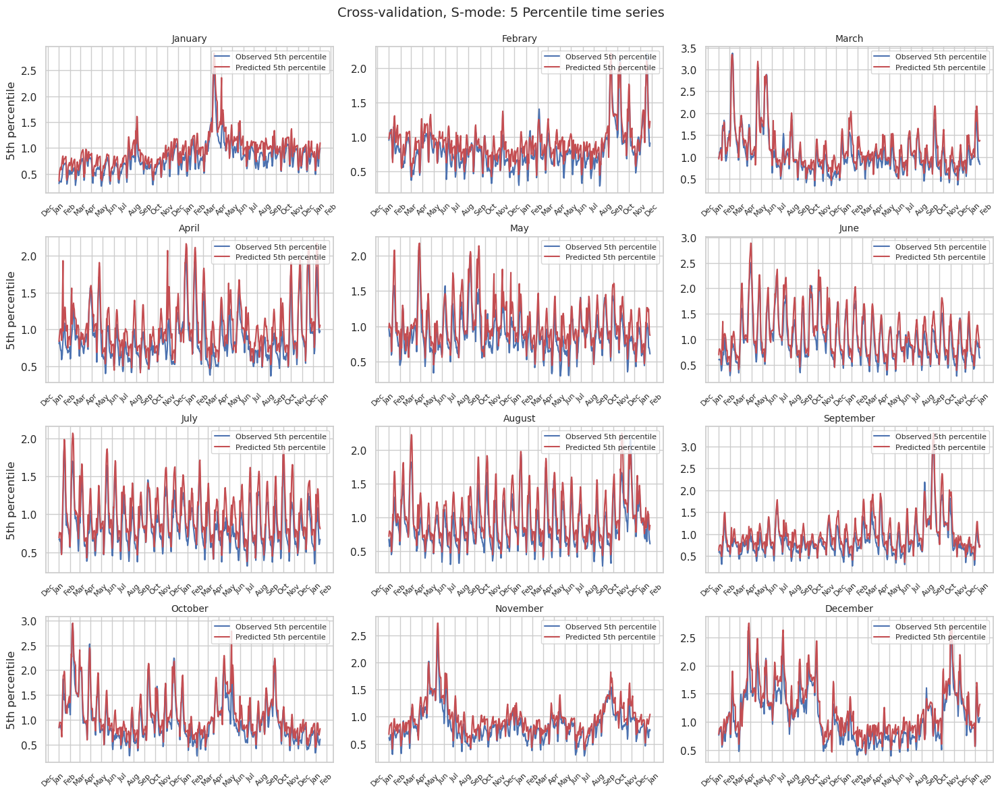

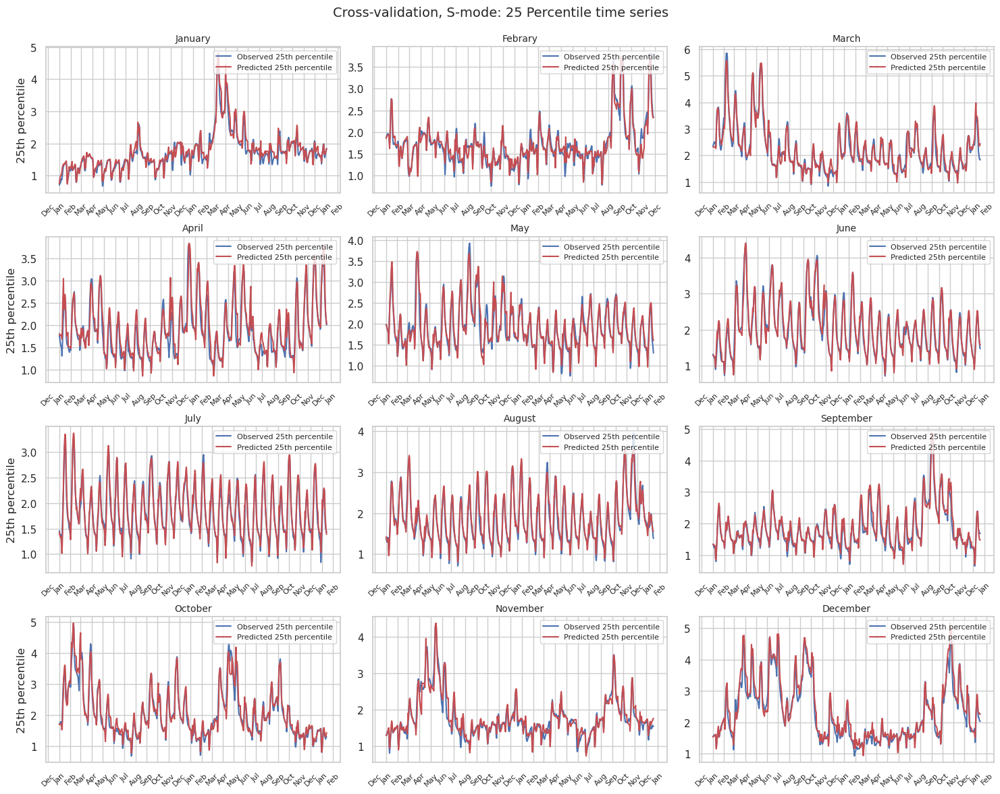

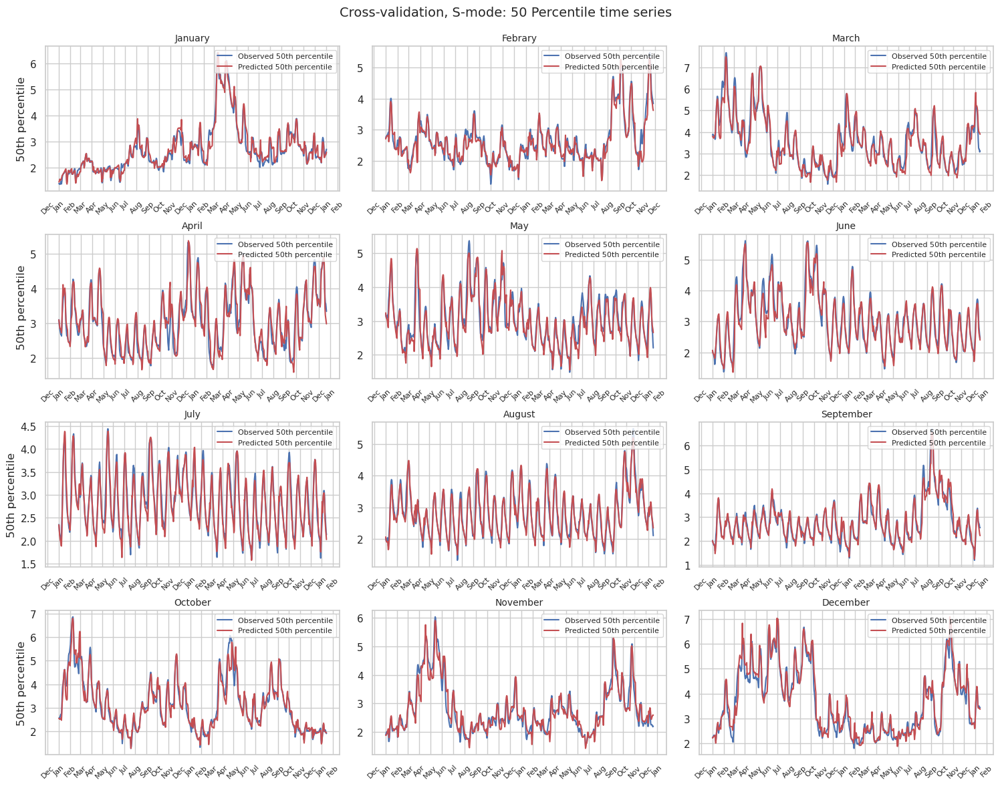

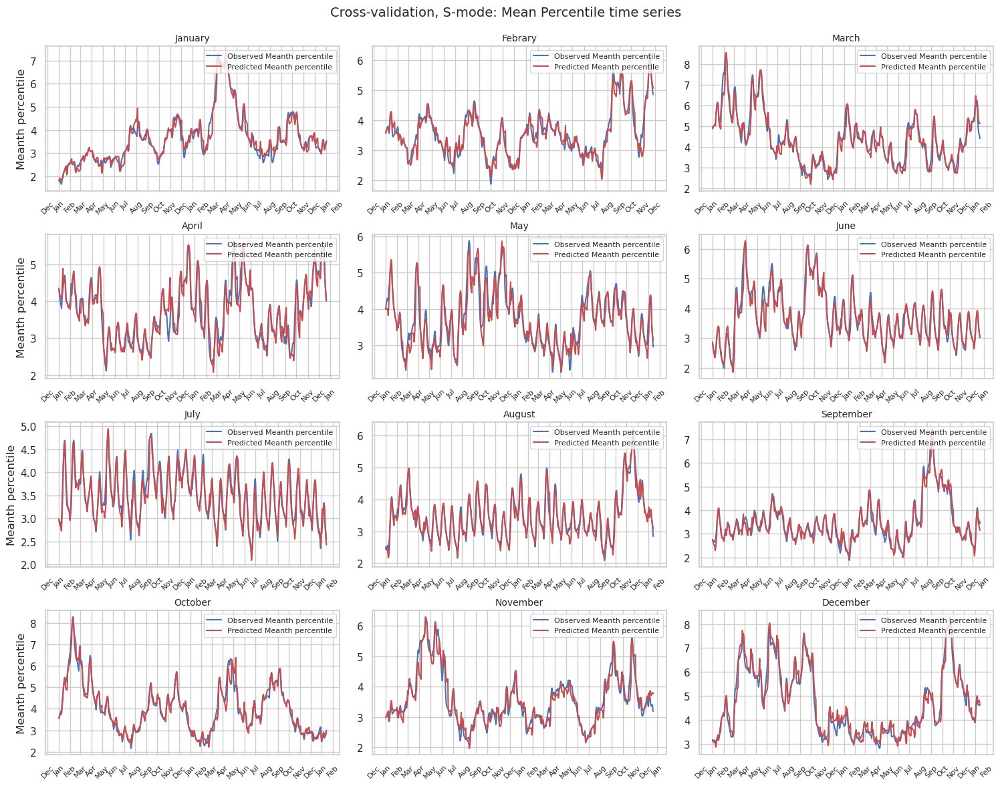

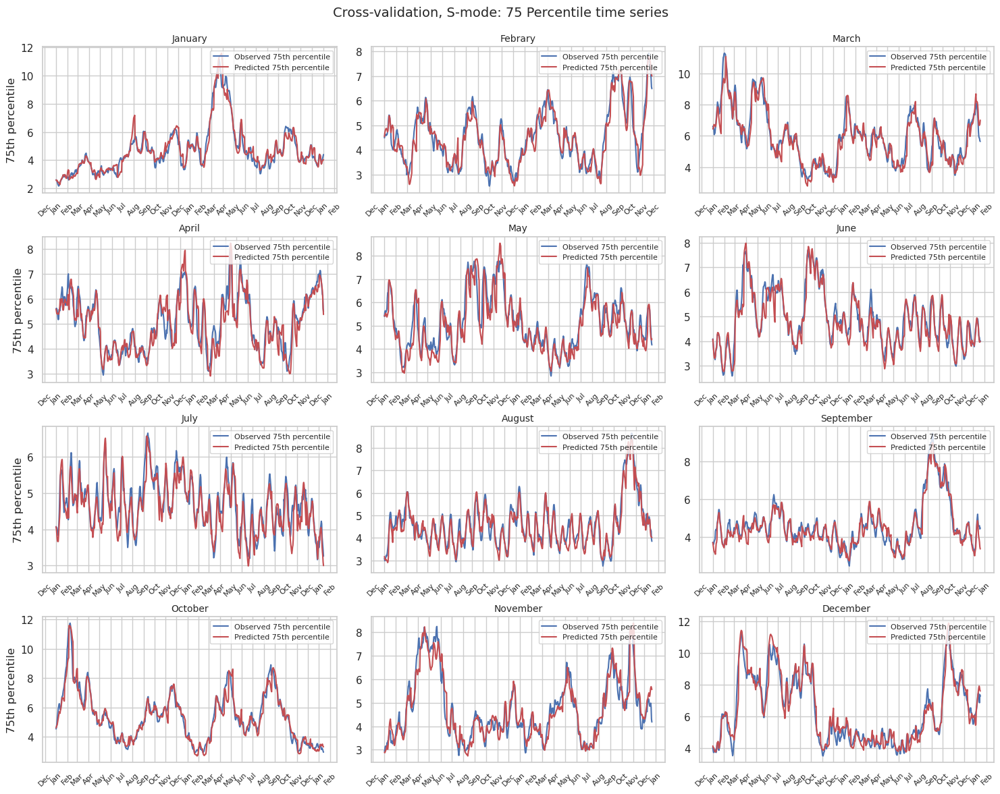

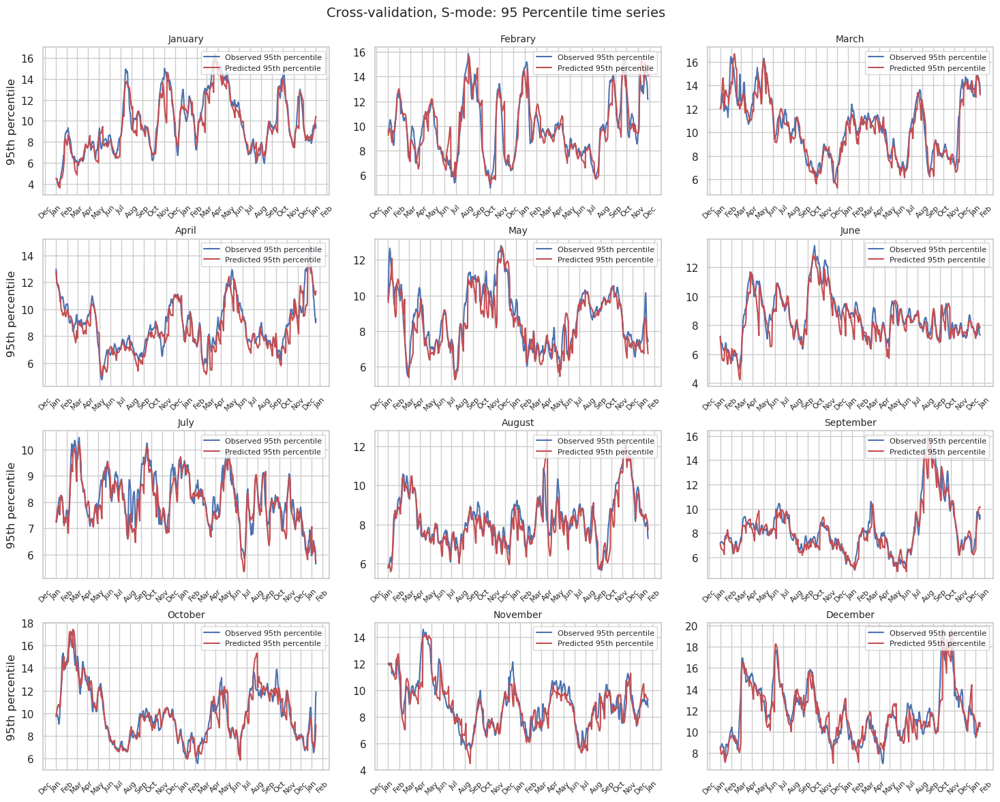

In [24]:
Temporal_Serie_S_Percentiles(Percentiles_S, percentiles[0])
Temporal_Serie_S_Percentiles(Percentiles_S, percentiles[1])
Temporal_Serie_S_Percentiles(Percentiles_S, percentiles[2])
Temporal_Serie_S_Percentiles(Percentiles_S, percentiles[3])
Temporal_Serie_S_Percentiles(Percentiles_S, percentiles[4])
Temporal_Serie_S_Percentiles(Percentiles_S, percentiles[5])

#### T-mode

In [25]:
# Definir los percentiles
percentiles = [5, 25, 50, 75, 95]

# Inicializar el diccionario de resultados
results = {
    "Month": [],
    "Latitude": [],
    "Longitude": [],
    "Percentile": [],
    "Value": [],
    "Type": []
}

# Iterar por cada mes (1 a 12)
for month in range(1, 13):
    print(f'Month: {month}')
    
    # Filtrar datos por mes
    pred_month = valid_preds.sel(time=valid_preds.time.dt.month == month)
    obs_month = valid_target.sel(time=valid_target.time.dt.month == month)
    
    # Iterar sobre las coordenadas de latitud y longitud
    for lat_idx, lat in enumerate(pred_month.latitude):
        print('Latitude: ', lat_idx)
        for lon_idx, lon in enumerate(pred_month.longitude):
            
            # Extraer los valores para ese punto de latitud y longitud (vectorizado)
            pred_values = pred_month[:, lat_idx, lon_idx].values  # Datos de predicción para este punto
            obs_values = obs_month[:, lat_idx, lon_idx].values  # Datos observados para este punto
            
            # Calcular los percentiles y la media para este punto
            for p in percentiles:
                # Para Predicción
                results["Month"].append(month)
                results["Latitude"].append(lat.values)
                results["Longitude"].append(lon.values)
                results["Percentile"].append(p)
                results["Value"].append(np.percentile(pred_values, p))
                results["Type"].append("Predicted")
                
                # Para Observado
                results["Month"].append(month)
                results["Latitude"].append(lat.values)
                results["Longitude"].append(lon.values)
                results["Percentile"].append(p)
                results["Value"].append(np.percentile(obs_values, p))
                results["Type"].append("Observed")
            
            # Calcular la media para este punto
            results["Month"].append(month)
            results["Latitude"].append(lat.values)
            results["Longitude"].append(lon.values)
            results["Percentile"].append('Mean')
            results["Value"].append(np.mean(pred_values))
            results["Type"].append("Predicted")
            
            results["Month"].append(month)
            results["Latitude"].append(lat.values)
            results["Longitude"].append(lon.values)
            results["Percentile"].append('Mean')
            results["Value"].append(np.mean(obs_values))
            results["Type"].append("Observed")

# Convertir los resultados a un DataFrame para análisis posterior
percentiles_T = pd.DataFrame(results, columns=['Month', 'Latitude', 'Longitude', 'Percentile', 'Value', 'Type'])

Month: 1
Latitude:  0
Latitude:  1
Latitude:  2
Latitude:  3
Latitude:  4
Latitude:  5
Latitude:  6
Latitude:  7
Latitude:  8
Latitude:  9
Latitude:  10
Latitude:  11
Latitude:  12
Latitude:  13
Latitude:  14
Latitude:  15
Latitude:  16
Latitude:  17
Latitude:  18
Latitude:  19
Latitude:  20
Latitude:  21
Latitude:  22
Latitude:  23
Latitude:  24
Latitude:  25
Latitude:  26
Latitude:  27
Latitude:  28
Latitude:  29
Latitude:  30
Latitude:  31
Latitude:  32
Latitude:  33
Latitude:  34
Latitude:  35
Latitude:  36
Latitude:  37
Latitude:  38
Latitude:  39
Latitude:  40
Latitude:  41
Latitude:  42
Latitude:  43
Latitude:  44
Latitude:  45
Latitude:  46
Latitude:  47
Latitude:  48
Latitude:  49
Latitude:  50
Latitude:  51
Latitude:  52
Latitude:  53
Latitude:  54
Latitude:  55
Latitude:  56
Latitude:  57
Latitude:  58
Latitude:  59
Latitude:  60
Latitude:  61
Latitude:  62
Latitude:  63
Latitude:  64
Latitude:  65
Latitude:  66
Latitude:  67
Latitude:  68
Latitude:  69
Latitude:  70
Latitud

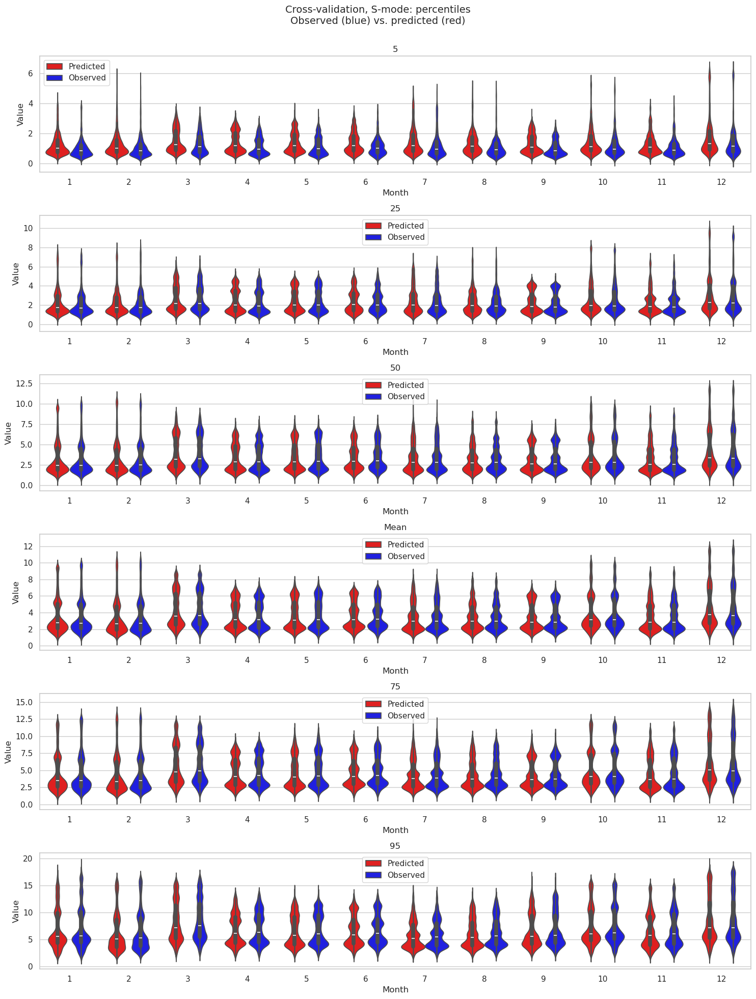

In [26]:
# Crear la figura y los subplots
percentiles = [5, 25, 50, 'Mean', 75, 95]

fig, axes = plt.subplots(6, 1, figsize=(15, 20))#, sharex=True, sharey=True)
axes = axes.flatten()

for i, percentile in enumerate(percentiles):
    ax = axes[i]
    sns.violinplot(data=percentiles_T[percentiles_T['Percentile'] == percentile], x='Month', y='Value', hue='Type', dodge=True, palette={'Observed': 'blue', 'Predicted': 'red'}, ax=ax, legend=True)
    ax.set_title(percentile)
    ax.set_ylabel('Value')
    ax.set_xlabel('Month')
    ax.legend(loc='best')

# Ajustar leyenda y diseño
fig.suptitle('Cross-validation, S-mode: percentiles\nObserved (blue) vs. predicted (red)', fontsize=14)
plt.tight_layout()
plt.subplots_adjust(top=0.93)
pdf.savefig()
plt.show()

#### T-mode serie of each percentile

In [188]:
def T_Serie_Percentiles(data, percentile, cost_lines=True):
    '''
    Plot of monthly temporal series of a given percentile.
    Input:
    - data (DataFrame): DataFrame with the data.
    - percentile (str): Percentile to plot.
    '''

    # extent of data
    extent = [-10.3, 5, 31, 46.4]

    # Create the figure and subplots
    if cost_lines:
        fig, axes = plt.subplots(figsize=(13, 10), nrows=4, ncols=3, subplot_kw={'projection': ccrs.PlateCarree()})
    else:
        fig, axes = plt.subplots(figsize=(13, 10), nrows=4, ncols=3)

    axes = axes.flatten()

    # Iterate over the months (1 to 12)
    for month in range(1, 13):
        # Filter data by month
        df_month = data[data["Month"] == month]
    
        # Filter data by percentile
        df_p = df_month[df_month["Percentile"] == percentile]        
        
        ax = axes[month - 1]

        df_p.loc[:, "Longitude"] = df_p["Longitude"].astype(float)
        df_p.loc[:, "Latitude"] = df_p["Latitude"].astype(float)


        lon = df_p[df_p["Type"] == "Observed"]["Longitude"].unique()
        lat = df_p[df_p["Type"] == "Observed"]["Latitude"].unique()

        obs = df_p[df_p["Type"] == "Observed"]["Value"].values
        pred = df_p[df_p["Type"] == "Predicted"]["Value"].values
        data_diff = (obs - pred).reshape(144,144)

        if cost_lines:
            ax.set_extent(extent)
            #ax.gridlines(alpha=0.8)
            gls = ax.gridlines(alpha=0.5, draw_labels=True, dms=True)
            gls.right_labels = False
            gls.top_labels = False
            ax.coastlines(resolution='10m')

        vmin, vmax = data_diff.min(), data_diff.max()
        im = ax.pcolormesh(lon, lat, data_diff, cmap=cmap, vmin=vmin, vmax=vmax)
        cbar = plt.colorbar(im, ax=ax,fraction=0.046, pad=0.04)
        cbar.set_label(label=f'{percentile}th Percentil',size=14, labelpad=10)
    
        ax.set_title(months_names[i])
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        #ax.legend()
    
        ax.set_title(f"{months_names[month - 1]}", fontsize=10)
        #ax.legend(loc="upper right", fontsize=8)
        ax.set_ylabel(f"{percentile}th percentile (Difference)", fontsize=8)
        # To only show labels some subplots 
        if (month - 1) % 3 != 0:
            ax.set_ylabel("")
        #ax.set_xlabel("")



    plt.tight_layout()
    plt.suptitle(f"Cross-validation, T-mode: {percentile} Percentile time series", fontsize=14)
    plt.subplots_adjust(top=0.95, hspace=0.3)
    pdf.savefig()
    plt.show()

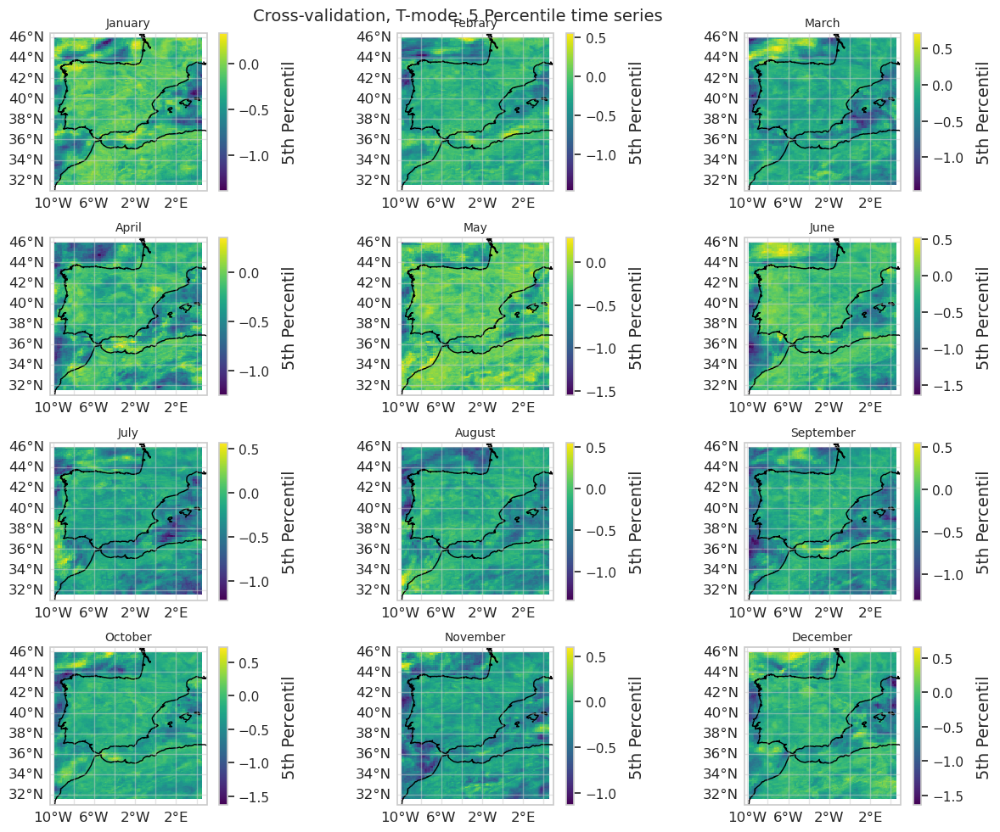

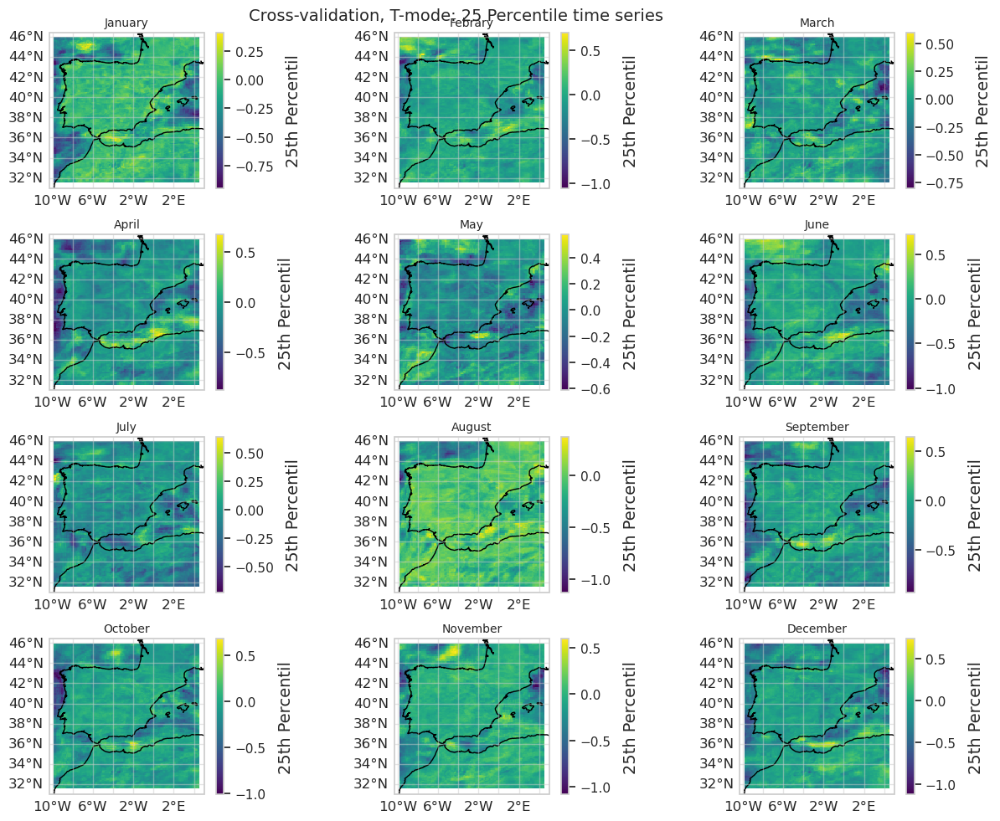

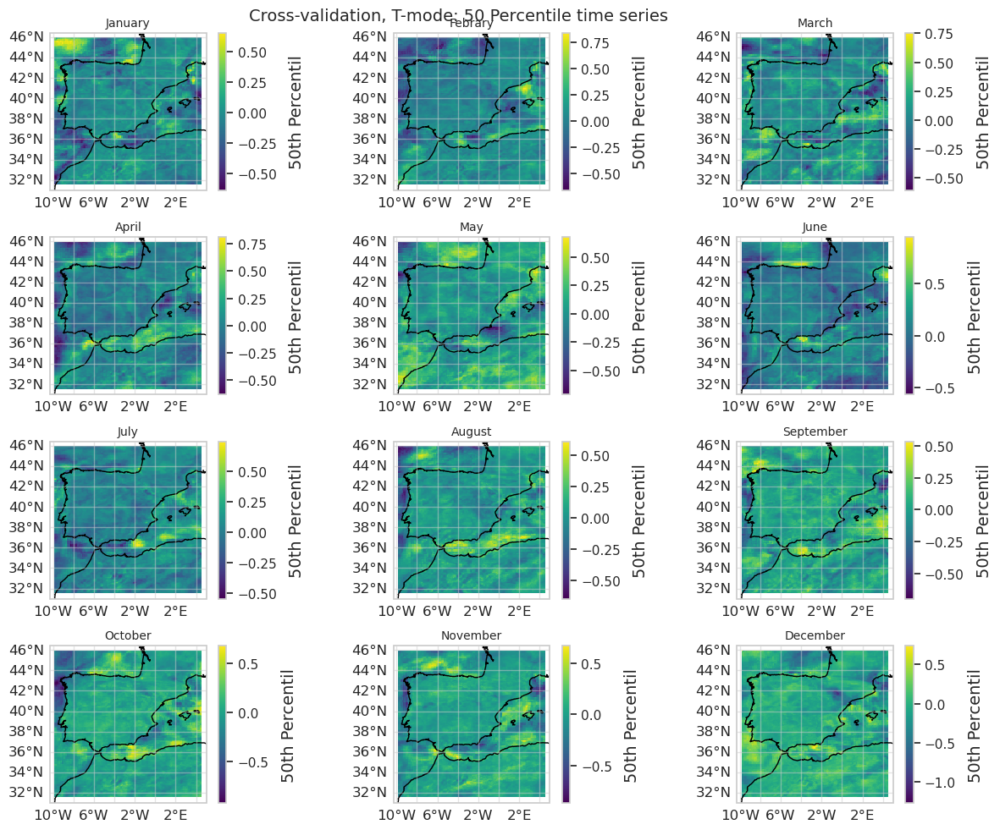

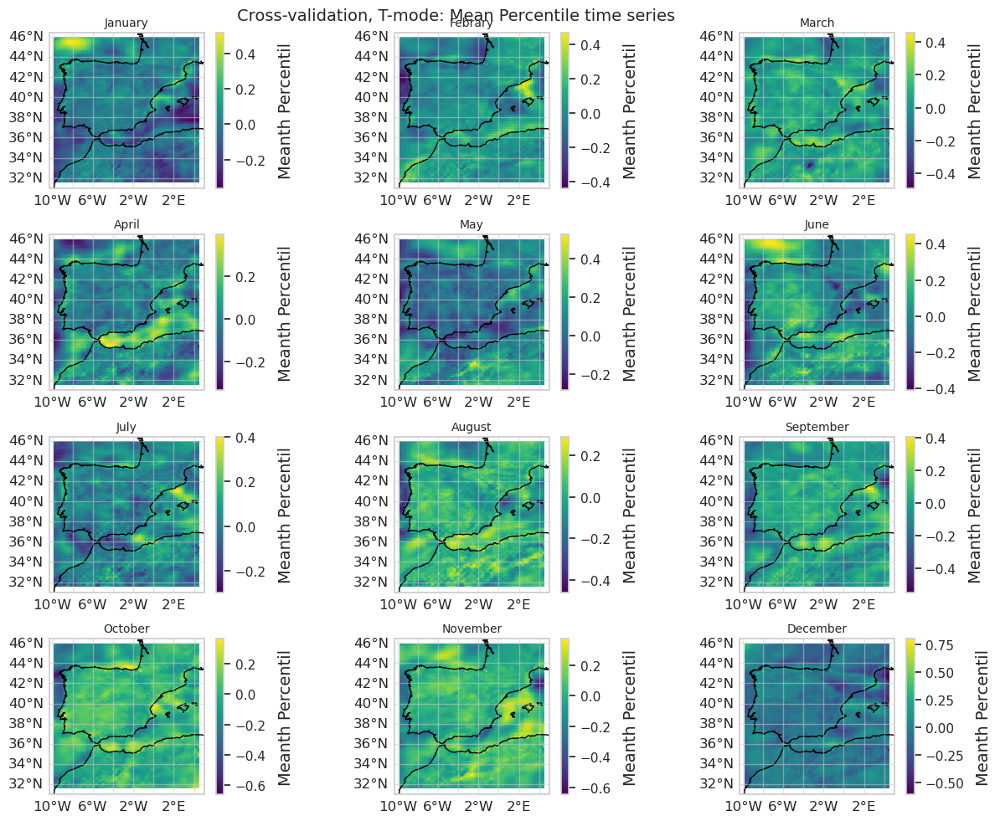

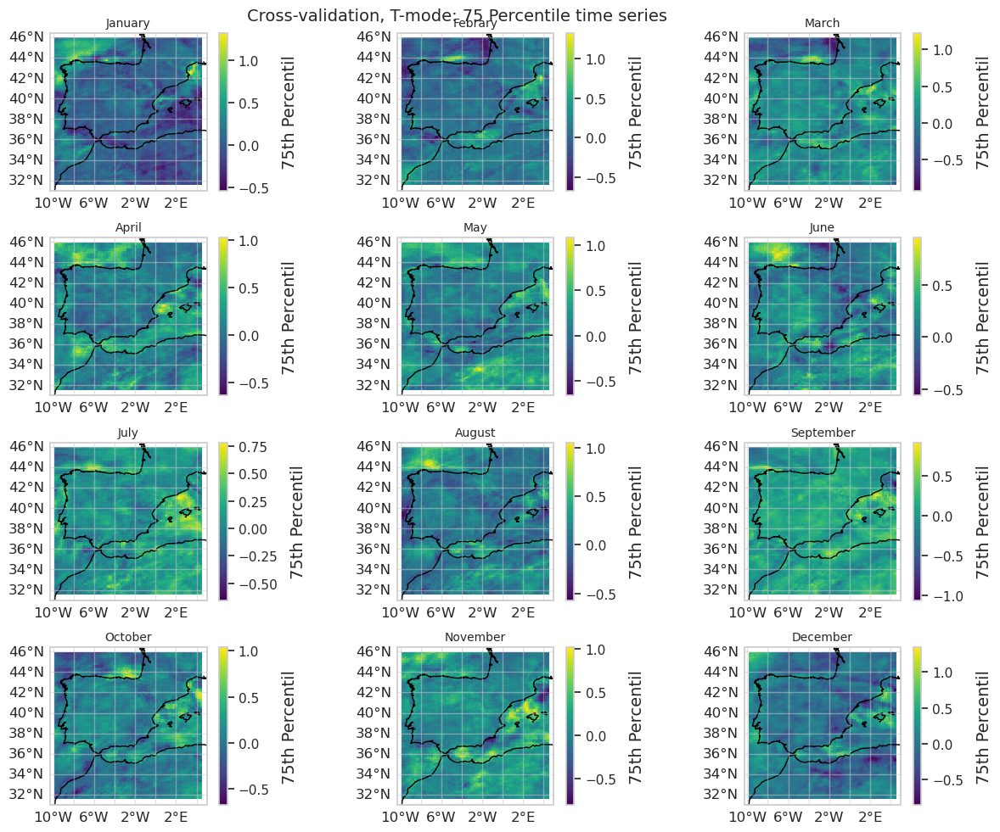

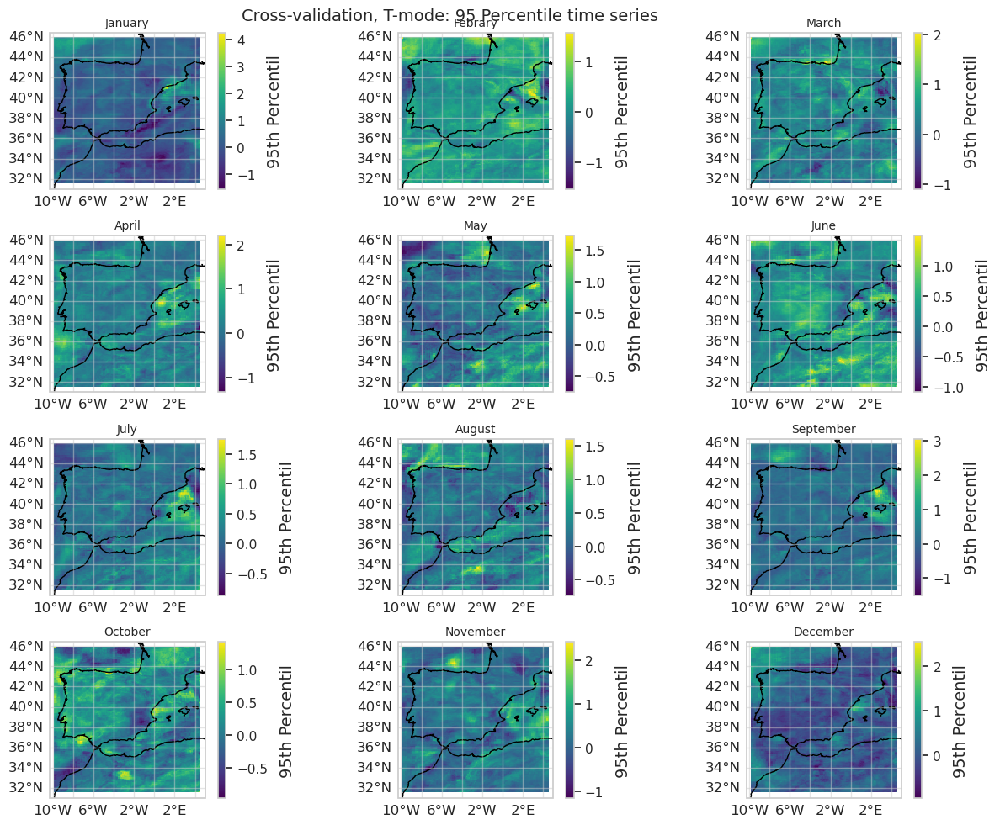

In [189]:
T_Serie_Percentiles(percentiles_T, percentiles[0])
T_Serie_Percentiles(percentiles_T, percentiles[1])
T_Serie_Percentiles(percentiles_T, percentiles[2])
T_Serie_Percentiles(percentiles_T, percentiles[3])
T_Serie_Percentiles(percentiles_T, percentiles[4])
T_Serie_Percentiles(percentiles_T, percentiles[5])

#### Metrics (Spatial/Temporal mode)

In [190]:
def calculate_metrics_S(obs, pred):
    '''
    Calculates metrics in S mode, that is, in the spatial axis, for the cross-validation
    input:
        obs: xarray.DataArray with observed values
        pred: xarray.DataArray with predicted values
    output:
        metrics: list with calculated S-metrics
    '''
    mae = abs(pred - obs).mean(dim=['latitude', 'longitude'])    
    me = (obs - pred).mean(dim=['latitude', 'longitude'])
    rsd = (pred.std(dim=['latitude', 'longitude']) / obs.std(dim=['latitude', 'longitude']))
    corr = xr.corr(obs, pred, dim=['latitude', 'longitude'])
    a_corr = xr.corr(obs - obs.mean(dim=['latitude', 'longitude']), pred - pred.mean(dim=['latitude', 'longitude']), dim=['latitude', 'longitude'])
    kge = 1 - np.sqrt((corr - 1)**2 + (rsd - 1)**2 + (pred.mean(dim=['latitude', 'longitude']) / obs.mean(dim=['latitude', 'longitude']) - 1)**2)
    #d = 1 - ((obs - pred)**2).sum(dim=['latitude', 'longitude']) / ((np.abs(pred - pred.mean(dim=['latitude', 'longitude'])) + np.abs(obs - obs.mean(dim=['latitude', 'longitude'])))**2).sum()

    metrics = [mae, me, rsd, corr, a_corr, kge]

    return metrics

In [191]:
def calculate_metrics_T(obs, pred):
    '''
    Calculates metrics in T mode, that is, in the temporal axis, for the cross-validation
    input:
        obs: xarray.DataArray with observed values
        pred: xarray.DataArray with predicted values
    output:
        metrics: list with calculated T-metrics
    '''
    mae = abs(pred - obs).mean(dim='time')    
    me = (obs - pred).mean(dim='time')
    rsd = (pred.std(dim='time') / obs.std(dim='time'))
    corr = xr.corr(obs, pred, dim='time')
    a_corr = xr.corr(obs - obs.mean(dim='time'), pred - pred.mean(dim='time'), dim='time')
    kge = 1 - np.sqrt((corr - 1)**2 + (rsd - 1)**2 + (pred.mean(dim='time') / obs.mean(dim='time') - 1)**2)
    #d = 1 - ((obs - pred)**2).sum(dim='time') / ((np.abs(pred - pred.mean(dim='time')) + np.abs(obs - obs.mean(dim='time')))**2).sum()

    metrics = [mae, me, rsd, corr, a_corr, kge]

    return metrics

#### Total metrics

In [192]:
print('Calculating S metrics')
metrics_S = calculate_metrics_S(valid_target, valid_preds)
print('Calculating T metrics')
metrics_T = calculate_metrics_T(valid_target, valid_preds)

Calculating S metrics
Calculating T metrics


In [193]:
def plot_metrics_S(metrics, titles):
    """
    Function to visualize the S-metrics as a function of the time.
    
    Input:
    - metrics: list with calculated S-metrics [mae, me, rsd, corr, kge, d] as a function of the time.
    - titles: list of metric names, which are used for the sub-titles (as default: ['MAE', 'ME', 'RSD', 'Correlation', 'Anomaly Correlation', KGE']).
    """
    
    # Create a plot with 6 different subplots (2 rows and 3 columns)
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    axes = axes.flatten()  # Flat axes for easier iteration
    
    # plot the S-metrics
    for i in range(6):
        axes[i].plot(metrics[i].time, metrics[i], label=titles[i], color='b')
        axes[i].set_title(titles[i])
        axes[i].set_xlabel('Time')
        axes[i].set_ylabel(titles[i])
        axes[i].grid(visible=True, color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

        # configure the x-axis to show the month
        axes[i].xaxis.set_major_locator(mdates.MonthLocator(interval=1))  # Un tick por mes
        axes[i].xaxis.set_major_formatter(mdates.DateFormatter('%b'))  # Mostrar abreviatura del mes (e.g., 'Jan')


    # fit the layout in orde to avoid overlapping of subplots
    plt.tight_layout()
    plt.suptitle('Total S-mode metrics', fontsize=16)
    plt.subplots_adjust(top=0.93)
    pdf.savefig()
    plt.show()

In [194]:
def plot_metrics_T(metrics, titles, cost_lines=True):
    """
    Function to visualize the T-metrics as a function of the lat-lon.
    
    Input:
    - metrics: list with calculated T-metrics [mae, me, rsd, corr, kge, d] as a function of the lat-lon.
    - titles: list of metric names, which are used for the sub-titles (as default: ['MAE', 'ME', 'RSD', 'Correlation', 'Anomaly Correlation', KGE']).
    """

    # extent the plot
    extent = [-10.3, 5, 31, 46.4]
    
    # Create the plot with 6 different subplots (2 rows and 3 columns)
    if cost_lines:
        fig, axes = plt.subplots(2, 3, figsize=(18, 10), subplot_kw={'projection': ccrs.PlateCarree()})
    else:
        fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    axes = axes.flatten()  # Flat axes for easier iteration

    for i in range(0, 6):

        if cost_lines:
            axes[i].set_extent(extent)
            #axes[i].gridlines(alpha=0.8)
            gls = axes[i].gridlines(alpha=0.5, draw_labels=True, dms=True)
            gls.right_labels = False
            gls.top_labels = False
            axes[i].coastlines(resolution='10m')

        vmin, vmax = metrics[i].min(), metrics[i].max()
        im = axes[i].pcolormesh(metrics[i].longitude, metrics[i].latitude, metrics[i].values, cmap=cmap, vmin=vmin, vmax=vmax)
        cbar = plt.colorbar(im, ax=axes[i],fraction=0.046, pad=0.04)
        #cbar.set_label(label=r'Wind speed [ms$^{-1}$]',size=14, labelpad=10)
    
        axes[i].set_title(titles[i])
        axes[i].set_xlabel('Longitude')
        axes[i].set_ylabel('Latitude')
        #axes[i].legend()
    
    # Fit the layout in order to avoid overlapping of subplots
    plt.tight_layout()
    plt.suptitle('Total T-mode metrics', fontsize=16)
    plt.subplots_adjust(top=0.93)
    pdf.savefig()
    plt.show()

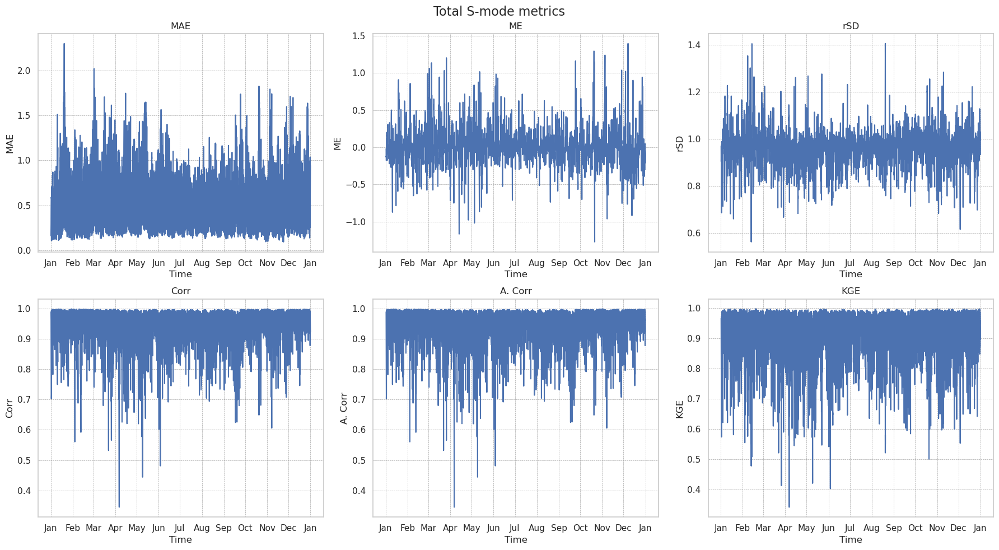

In [195]:
plot_metrics_S(metrics_S, titles)

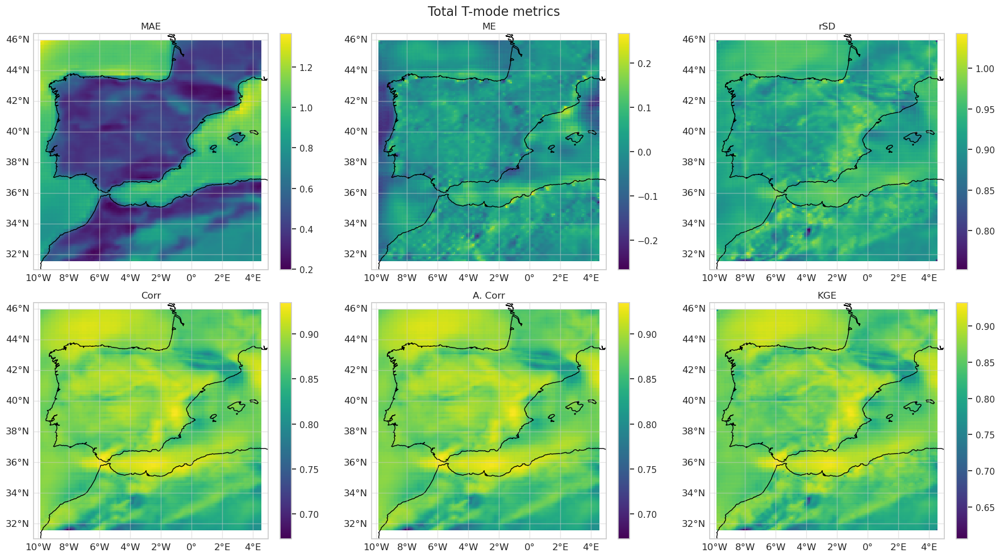

In [196]:
plot_metrics_T(metrics_T, titles, cost_lines=True)

#### Monthly metrics

In [197]:
month_list = []
metrics_S_month = []
metrics_T_month = []

for month in range(1, 13):
        
        print(months_names[month-1])

        # Select data
        valid_target_month = valid_target.sel(time=valid_target.time.dt.month == month)
        valid_preds_month = valid_preds.sel(time=valid_preds.time.dt.month == month)

        # Calculate metrics
        #print('Calculating S metrics')
        metrics_S_aux = calculate_metrics_S(valid_target_month, valid_preds_month)
        #print('Calculating T metrics')
        metrics_T_aux = calculate_metrics_T(valid_target_month, valid_preds_month)
        #print()

        # Save metrics
        month_list.append(month)
        metrics_S_month.append(metrics_S_aux)
        metrics_T_month.append(metrics_T_aux)


del valid_target_month, valid_preds_month, metrics_S_aux, metrics_T_aux

January
Febrary
March
April
May
June
July
August
September
October
November
December


In [198]:
for i, month in enumerate(months_names):
    print(f"{month}")  # Imprimir el nombre del mes
    print("\t\t".join(titles))  # Imprimir los nombres de las métricas

    # Formatear las métricas S en una línea
    metrics_S_values = "\t\t".join([f"{metrics_S_month[i][j].mean().values:.4f}" for j in range(len(titles))])
    print(metrics_S_values)

    # Formatear las métricas T en una línea
    metrics_T_values = "\t\t".join([f"{metrics_T_month[i][j].mean().values:.4f}" for j in range(len(titles))])
    print(metrics_T_values)

    print()  # Línea en blanco entre meses

January
MAE		ME		rSD		Corr		A. Corr		KGE
0.6564		-0.0088		0.9604		0.9291		0.9291		0.8859
0.6564		-0.0088		0.9347		0.8643		0.8643		0.8325

Febrary
MAE		ME		rSD		Corr		A. Corr		KGE
0.6313		0.0213		0.9843		0.9333		0.9333		0.8907
0.6313		0.0213		0.9297		0.8560		0.8560		0.8317

March
MAE		ME		rSD		Corr		A. Corr		KGE
0.7597		0.0520		0.9660		0.9214		0.9214		0.8855
0.7597		0.0520		0.9262		0.8744		0.8744		0.8474

April
MAE		ME		rSD		Corr		A. Corr		KGE
0.7205		0.0175		0.9384		0.8986		0.8986		0.8553
0.7205		0.0175		0.9169		0.8425		0.8425		0.8159

May
MAE		ME		rSD		Corr		A. Corr		KGE
0.6997		0.0633		0.9513		0.9045		0.9045		0.8669
0.6997		0.0633		0.9185		0.8306		0.8306		0.8044

June
MAE		ME		rSD		Corr		A. Corr		KGE
0.6361		0.0425		0.9554		0.9155		0.9155		0.8854
0.6361		0.0425		0.9171		0.8634		0.8634		0.8288

July
MAE		ME		rSD		Corr		A. Corr		KGE
0.5802		0.0233		0.9658		0.9269		0.9269		0.9049
0.5802		0.0233		0.9101		0.8280		0.8280		0.7997

August
MAE		ME		rSD		Corr		A. Corr		KGE
0.6102		0.0103		0.95

#### Violin distribution of statistics

In [199]:
def plot_monthly_violin(metrics_total, titles, months_names):
    """
    Función para generar un violin plot con la distribución de 12 conjuntos de datos (correspondientes a los 12 meses).
    
    Parámetros:
    - data_list: Lista de 12 conjuntos de datos correspondientes a cada mes.
    - titles: Lista de títulos para cada conjunto de datos (por defecto: ['Month 1', ..., 'Month 12']).
    """

    fig, axes = plt.subplots(6, 1, figsize=(14, 24))

    axes = axes.flatten()  

    for idx in range(len(axes)):

        metrics_total_flattened = [np.array(data[idx]).flatten() if isinstance(data, list) else data[idx].flatten() for data in metrics_total]
    
        # Crear el violin plot
        sns.violinplot(data=metrics_total_flattened, ax=axes[idx], bw_adjust=0.5)

        # Reference line
        if titles[idx] == 'ME':
            axes[idx].axhline(y=0, color='black', linewidth=2, linestyle='--') 
        else:
            axes[idx].axhline(y=1, color='black', linewidth=2, linestyle='--')  
    
        # Configurar los títulos de los ejes y los labels
        axes[idx].set_title(titles[idx], fontsize=16)
        axes[idx].set_xlabel('Month', fontsize=14)
        axes[idx].set_ylabel('Values', fontsize=14)
    
        # Etiquetas de los meses
        axes[idx].set_xticks(ticks=range(12), labels=months_names, rotation=45)
    
    # Mostrar el gráfico
    plt.tight_layout()
    plt.suptitle('Violin plots of metrics per month', fontsize=16)
    plt.subplots_adjust(top=0.95)
    pdf.savefig()
    plt.show()

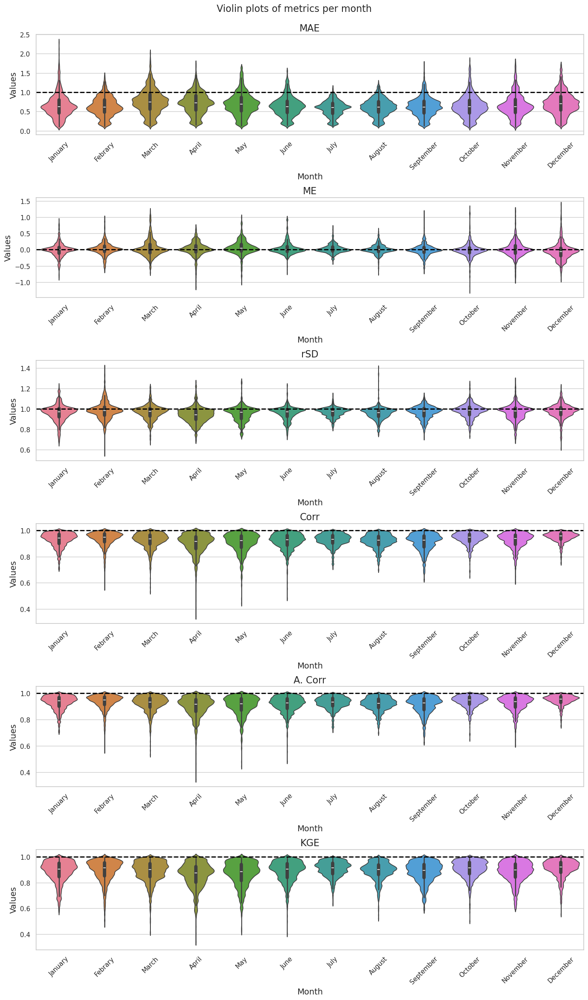

In [200]:
plot_monthly_violin(metrics_S_month, titles, months_names)

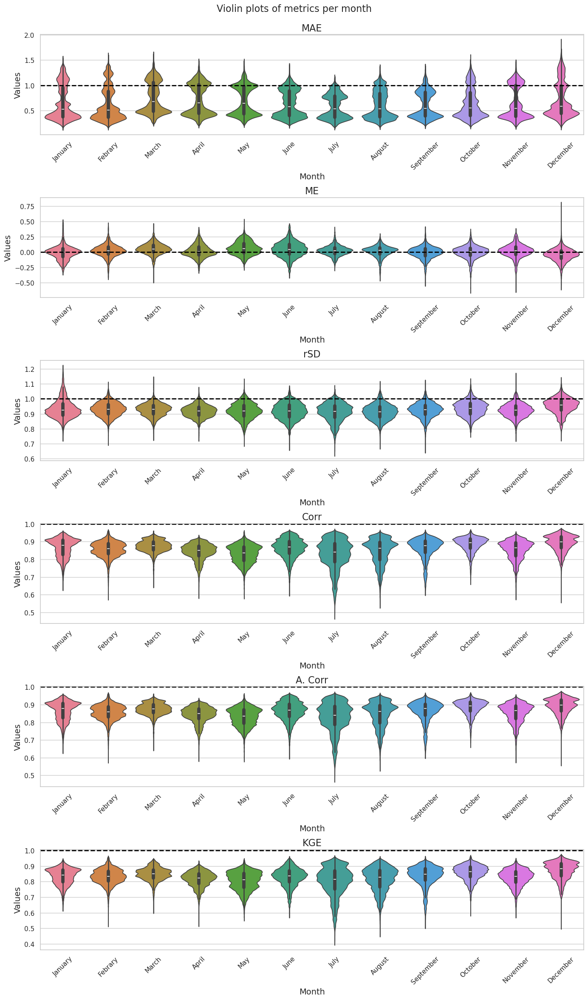

In [201]:
plot_monthly_violin(metrics_T_month, titles, months_names)

#### Monthly series of statistics

In [202]:
def plot_monthly_metrics_S(metrics_total, metric, titles):
    """
    Function to visualize the indivual S-metrics as a function of the time for each month.
    
    Input:
    - metrics_total: list with calculated S-metrics [mae, me, rsd, corr, kge, d] as a function of the time for each individual month.
    - metric: Individual S-metric as a function of the time.
    - titles: list of metric names, which are used for the sub-titles (as default: ['MAE', 'ME', 'RSD', 'Correlation', 'Anomaly Correlation', KGE']).
    """
    
    # Create the plot with 12 different subplots (4 rows and 3 columns)
    fig, axes = plt.subplots(4, 3, figsize=(18, 10))
    axes = axes.flatten()  # Aplanar los ejes para que sea más fácil acceder a ellos
    
    # Plot the monthly metrics as a function of the time
    for i in range(len(axes)): 
        time_days = metrics_total[i][metric].time.dt.strftime('%d').values
        axes[i].plot(time_days, metrics_total[i][metric], label=titles[metric], color='b')
        axes[i].set_title(months_names[i])
        axes[i].set_xlabel('Day')
        axes[i].set_ylabel(titles[metric])
        axes[i].grid(visible=True, color='gray', linestyle='--', linewidth=0.5, alpha=0.7)

        # Set the x-axis to show days
        axes[i].set_xticks(time_days[::len(time_days) // 12])  # Solo poner un tick por mes
        axes[i].set_xticklabels(time_days[::len(time_days) // 12])#, rotation=45)  # Poner etiquetas de los días con rotación si es necesario


    # Fit layout to avoid overlapping of subplots
    plt.tight_layout()
    plt.suptitle(f'Time series of {titles[metric]} in S-mode per month', fontsize=16)
    plt.subplots_adjust(top=0.9)
    pdf.savefig()
    plt.show()

In [203]:
def plot_monthly_metrics_T(metrics_total, metric, titles, cost_lines=True):
    """
    Function to visualize the indivual T-metrics as a function of the lat-lon for each month.
    
    Input:
    - metrics_total: list with calculated T-metrics [mae, me, rsd, corr, kge, d] as a function of the lat-lon for each individual month.
    - metric: Individual T-metric as a function of the lat-lon.
    - titles: list of metric names, which are used for the sub-titles (as default: ['MAE', 'ME', 'RSD', 'Correlation', 'Anomaly Correlation', KGE']).
    """

    # Extent axis for Spain
    extent = [-10.3, 5, 31, 46.4]
    
    # Create figure with 12 different subplots (4 rows and 3 columns)
    if cost_lines:
        fig, axes = plt.subplots(4, 3, figsize=(18, 18), subplot_kw={'projection': ccrs.PlateCarree()})
    else:
        fig, axes = plt.subplots(4, 3, figsize=(18, 18))
    axes = axes.flatten()  # Flatten the axes for easier iteration

    for i in range(len(axes)):

        if cost_lines:
            axes[i].set_extent(extent)
            #axes[i].gridlines(alpha=0.8)
            gls = axes[i].gridlines(alpha=0.5, draw_labels=True, dms=True)
            gls.right_labels = False
            gls.top_labels = False
            axes[i].coastlines(resolution='10m')

        vmin, vmax = metrics_total[i][metric].min(), metrics_total[i][metric].max()
        im = axes[i].pcolormesh(metrics_total[i][metric].longitude, metrics_total[i][metric].latitude, metrics_total[i][metric].values, cmap=cmap, vmin=vmin, vmax=vmax)
        cbar = plt.colorbar(im, ax=axes[i],fraction=0.046, pad=0.04)
        cbar.set_label(label=titles[metric],size=14, labelpad=10)
    
        axes[i].set_title(months_names[i])
        axes[i].set_xlabel('Longitude')
        axes[i].set_ylabel('Latitude')
        #axes[i].legend()
    
    # Fit the layout in order to avoid overlapping of subplots
    plt.tight_layout()
    plt.suptitle(f'Map of {titles[metric]} in T-mode per month', fontsize=16)
    plt.subplots_adjust(top=0.95)
    pdf.savefig()
    plt.show()

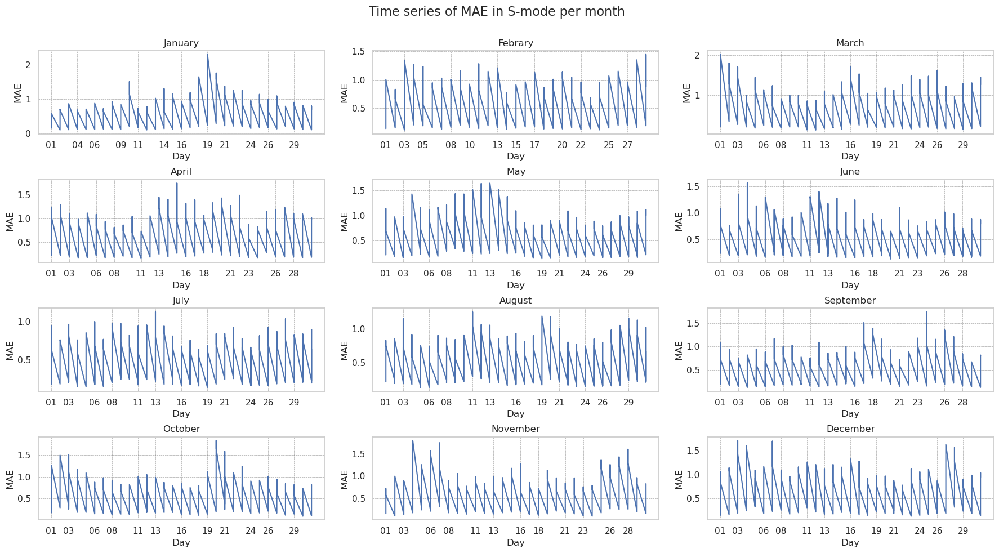

In [204]:
plot_monthly_metrics_S(metrics_S_month, 0, titles)

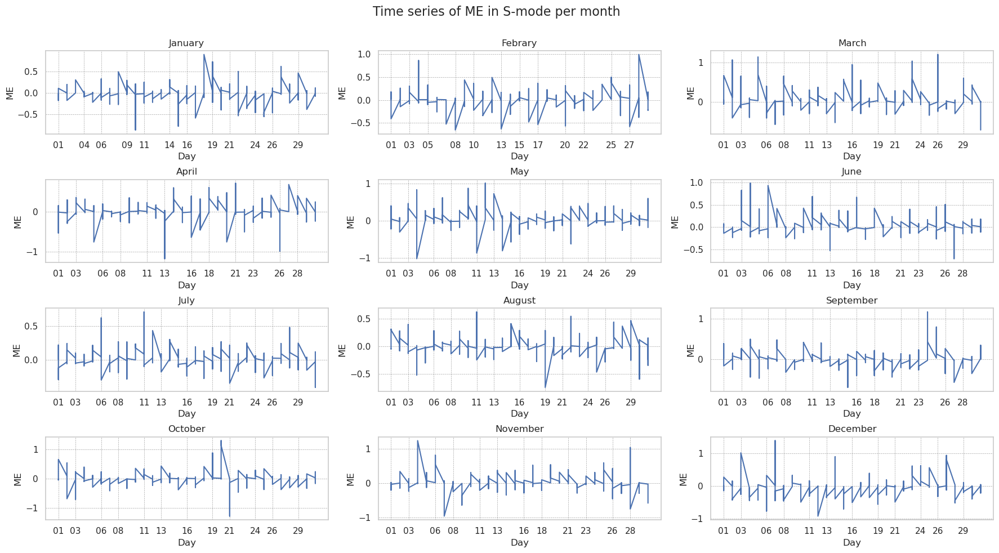

In [205]:
plot_monthly_metrics_S(metrics_S_month, 1, titles)

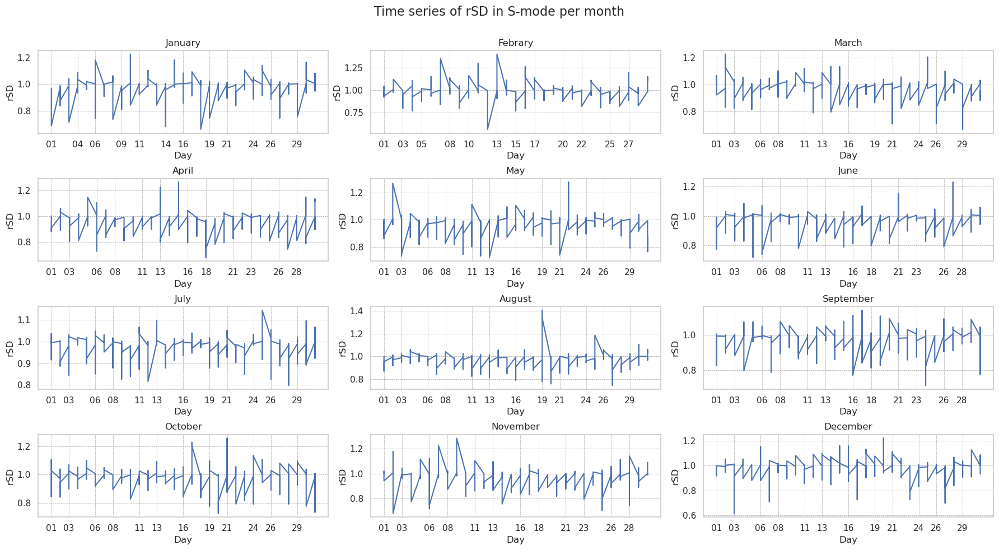

In [206]:
plot_monthly_metrics_S(metrics_S_month, 2, titles)

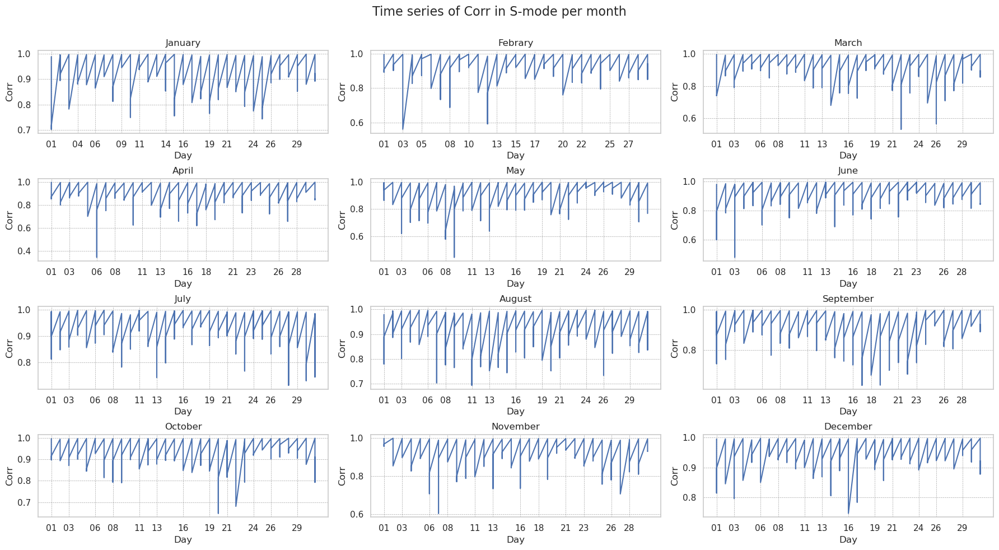

In [207]:
plot_monthly_metrics_S(metrics_S_month, 3, titles)

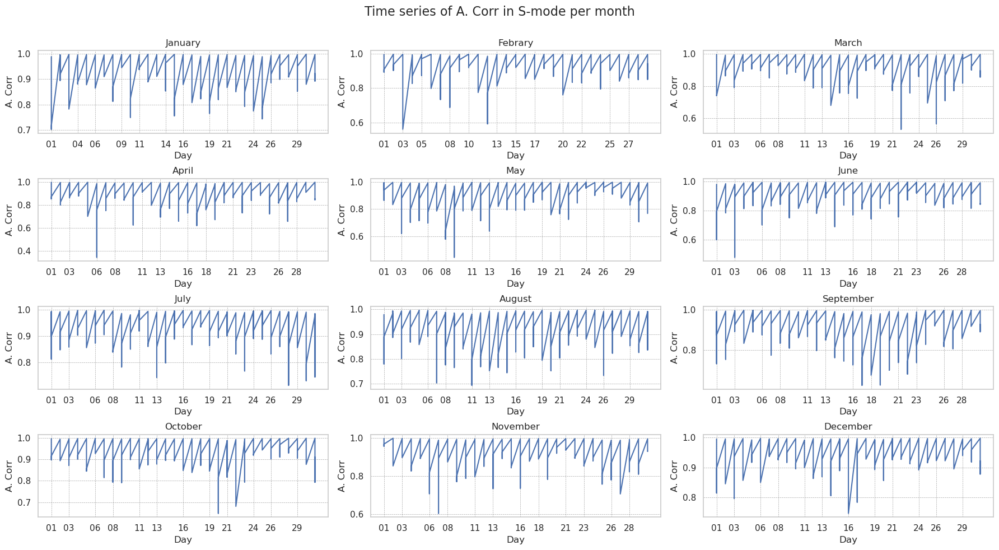

In [208]:
plot_monthly_metrics_S(metrics_S_month, 4, titles)

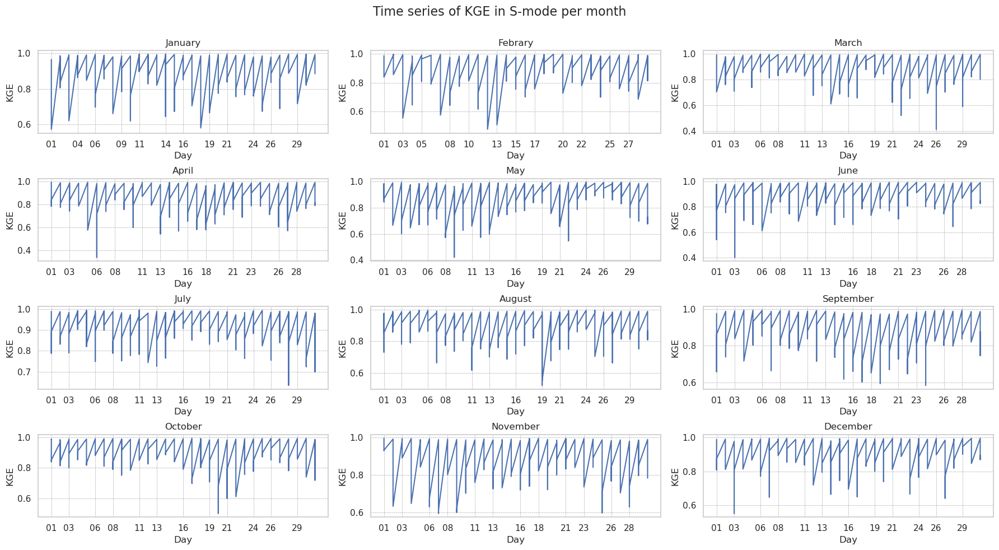

In [209]:
plot_monthly_metrics_S(metrics_S_month, 5, titles)

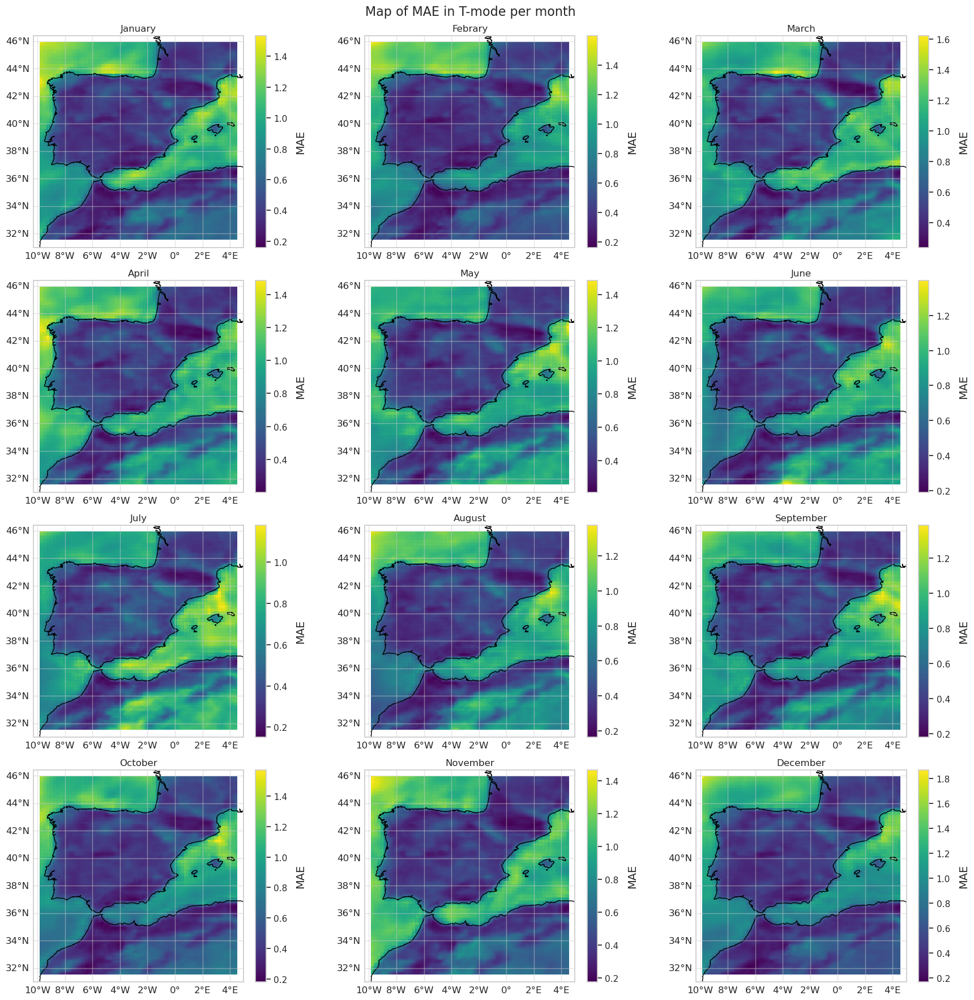

In [210]:
plot_monthly_metrics_T(metrics_T_month, 0, titles, cost_lines=True)

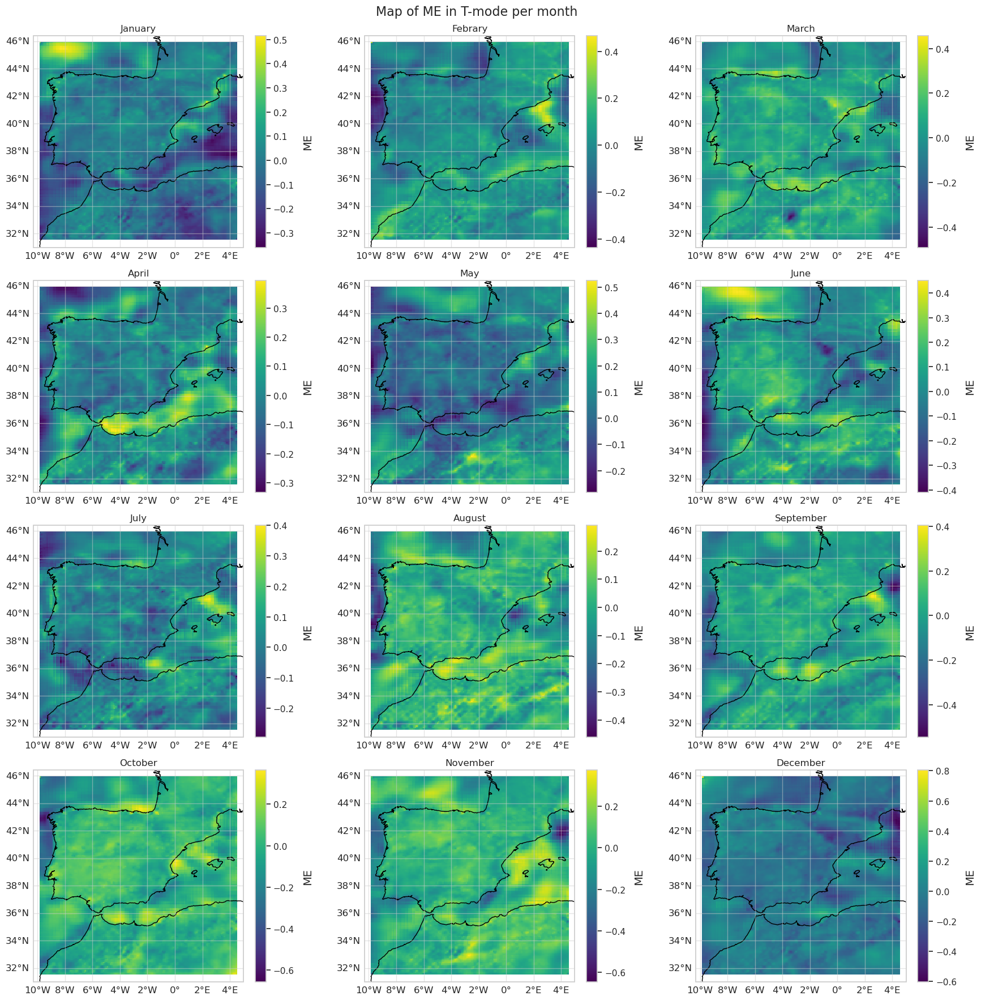

In [211]:
plot_monthly_metrics_T(metrics_T_month, 1, titles)

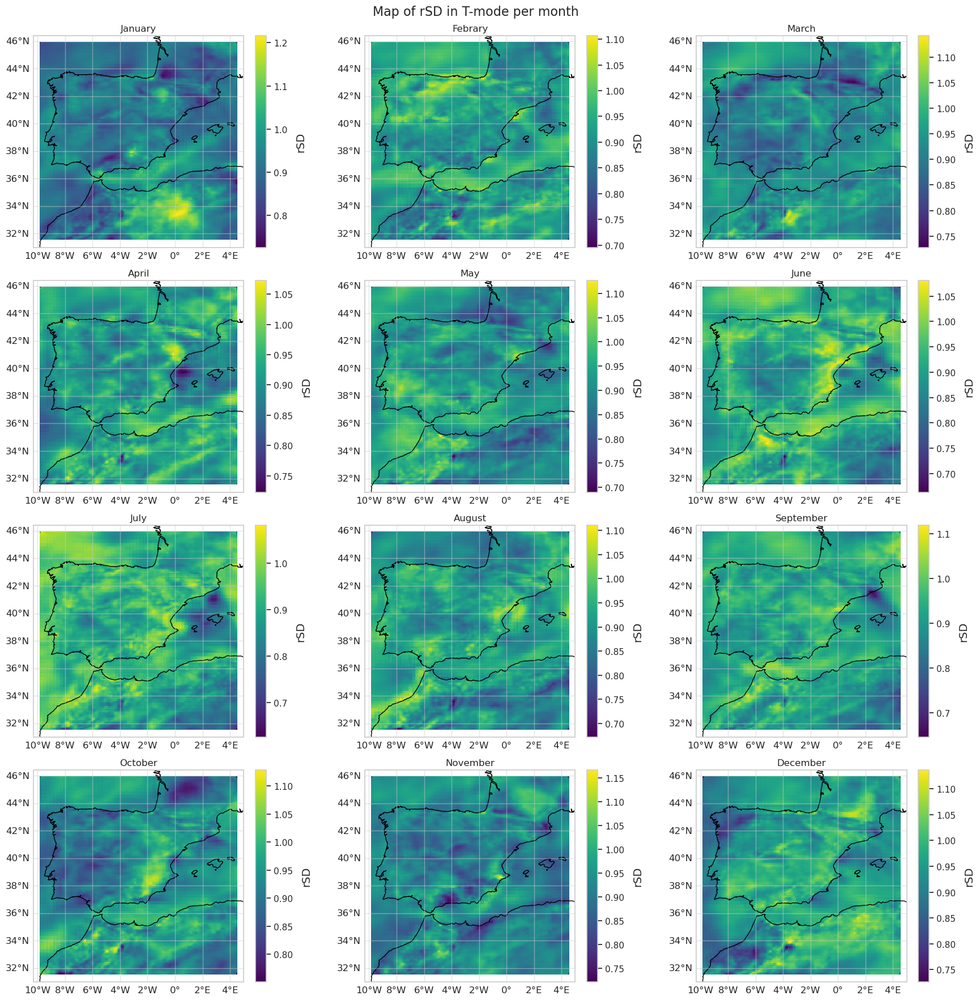

In [212]:
plot_monthly_metrics_T(metrics_T_month, 2, titles)

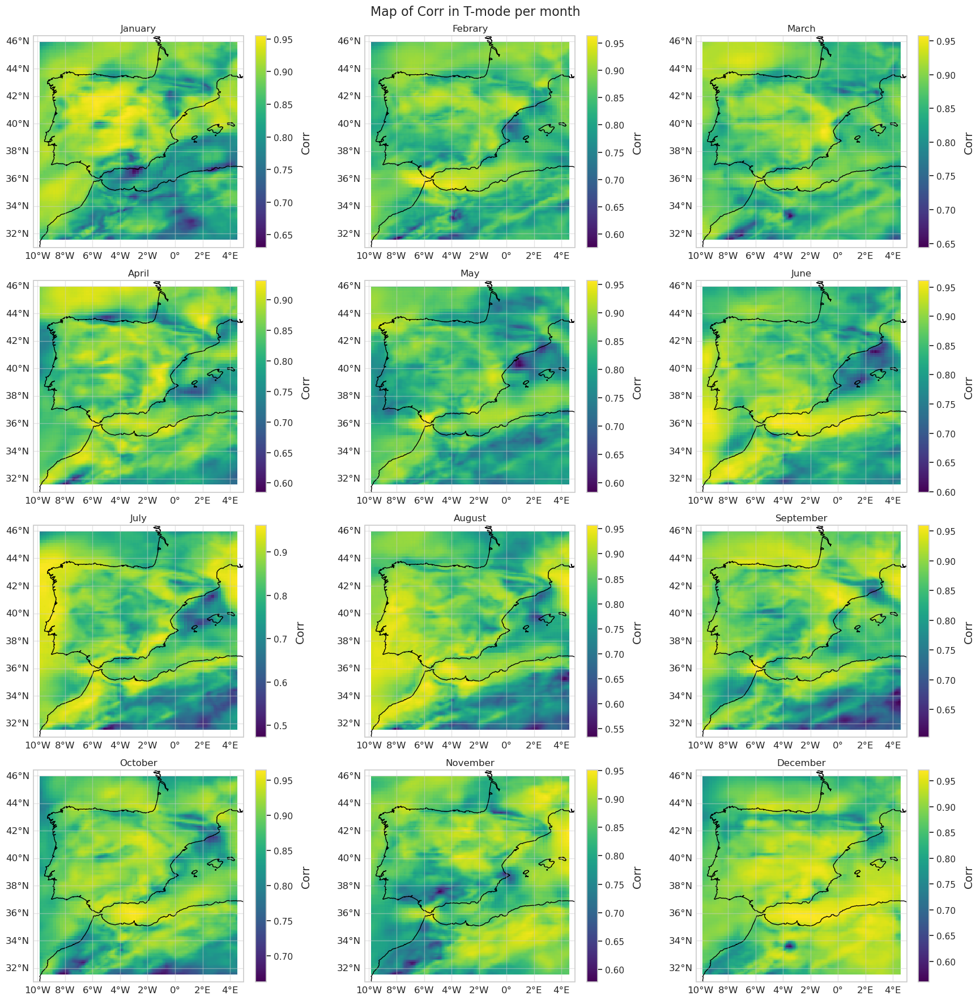

In [213]:
plot_monthly_metrics_T(metrics_T_month, 3, titles)

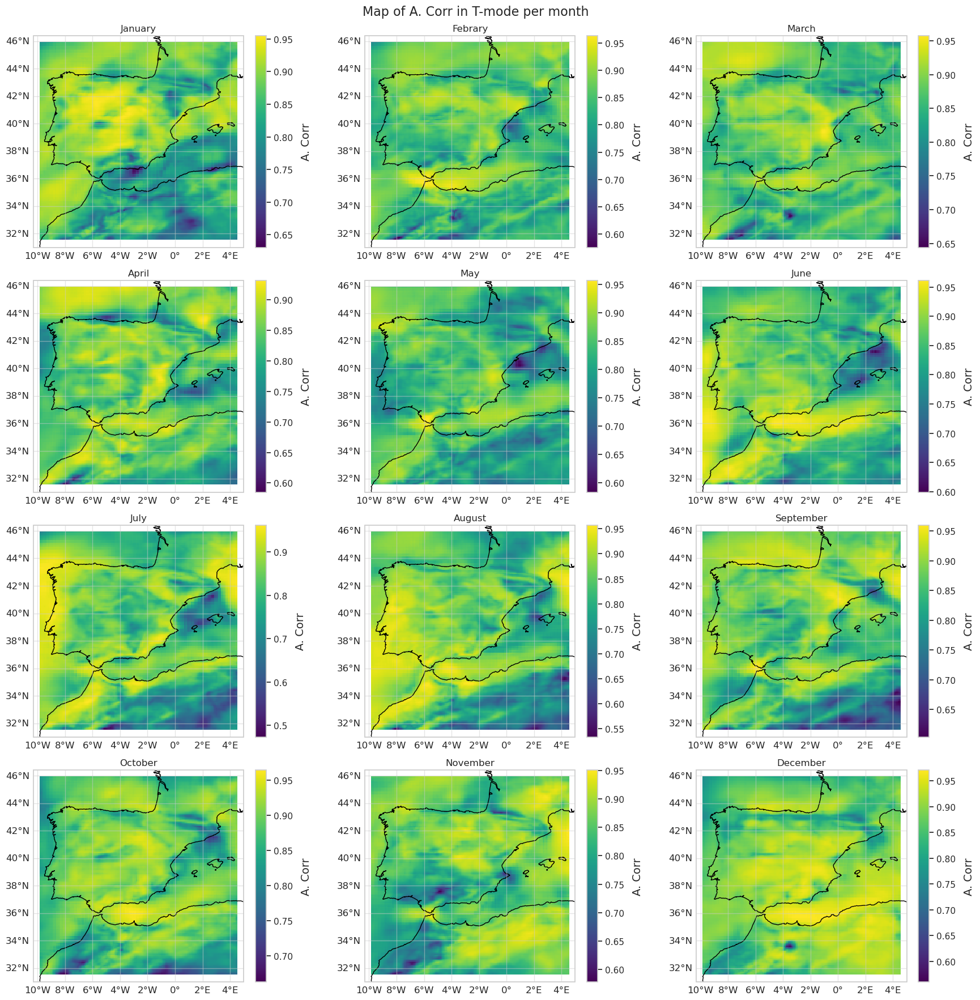

In [214]:
plot_monthly_metrics_T(metrics_T_month, 4, titles)

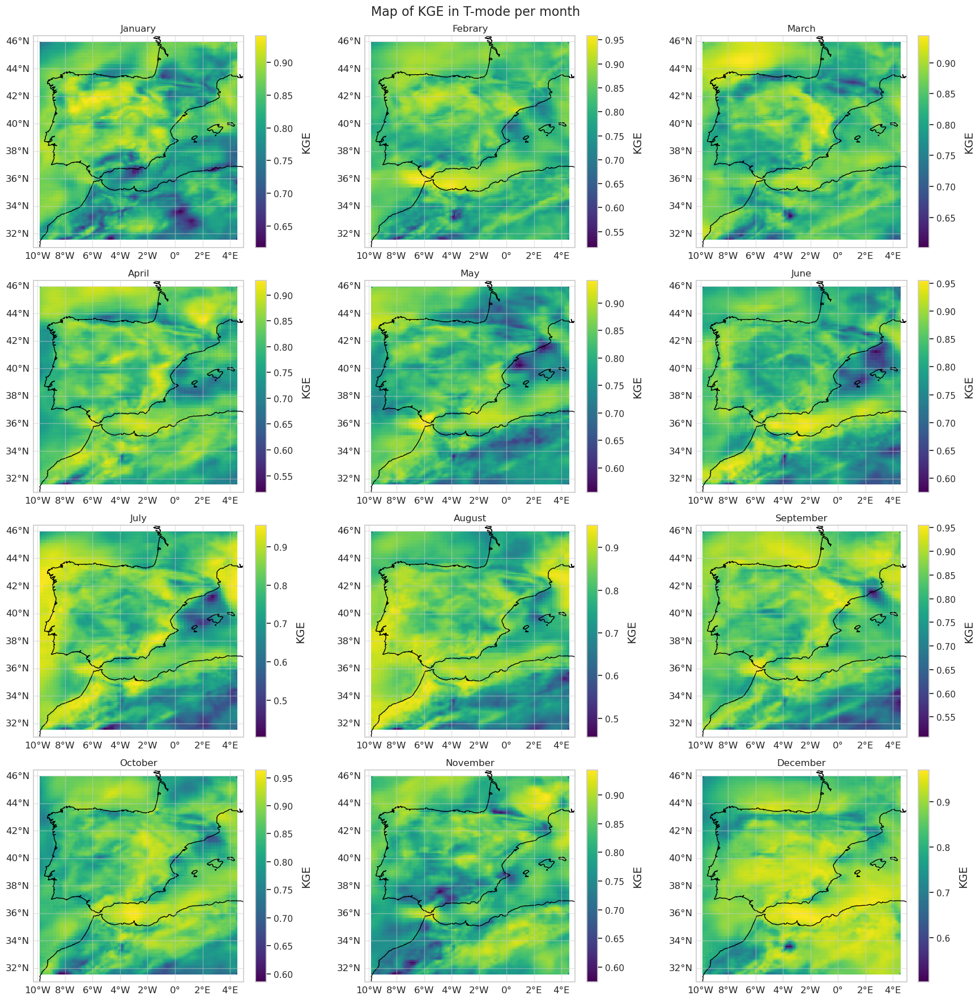

In [215]:
plot_monthly_metrics_T(metrics_T_month, 5, titles)

In [216]:
pdf.close()